# Computer Vision 2022 Assignment 2: Image matching and retrieval

In this prac, you will experiment with image feature detectors, descriptors and matching. There are 3 main parts to the prac:

- matching an object in a pair of images
- searching for an object in a collection of images
- analysis and discussion of results

## General instructions

As before, you will use this notebook to run your code and display your results and analysis. Again we will mark a PDF conversion of your notebook, referring to your code if necessary, so you should ensure your code output is formatted neatly. 

***When converting to PDF, include the outputs and analysis only, not your code.*** You can do this from the command line using the `nbconvert` command (installed as part of Jupyter) as follows:

    jupyter nbconvert Assignment2.ipynb --to pdf --no-input --TagRemovePreprocessor.remove_cell_tags 'remove-cell'

This will also remove the preamble text from each question. We will use the `OpenCV` library to complete the prac. It has several built in functions that will be useful. You are expected to consult documentation and use them appropriately.

This being the second assignment, we have provided less strict direction this time and you have more flexibility to choose how you answer each question. However you still need to ensure the outputs and report are clear and easy to read. This includes:

- sizing, arranging and captioning image outputs appropriately
- explaining what you have done clearly and concisely
- clearly separating answers to each question

## Data

We have provided some example images for this assignment, available through a link on the MyUni assignment page. The images are organised by subject matter, with one folder containing images of book covers, one of museum exhibits, and another of urban landmarks. Within each category, there is a “Reference” folder containing a clean image of each object and a “Query” folder containing images taken on a mobile device. Within each category, images with the same name contain the same object (so 001.jpg in the Reference folder contains the same book as 001.jpg in the Query folder).
The data is a subset of the Stanford Mobile Visual Search Dataset which is available at 

<http://web.cs.wpi.edu/~claypool/mmsys-dataset/2011/stanford/index.html>. 

The full data set contains more image categories and more query images of the objects we have provided, which may be useful for your testing!

Do not submit your own copy of the data or rename any files or folders! For marking, we will assume the datasets are available in subfolders of the working directory using the same folder names provided.

Here is some general setup code, which you can edit to suit your needs.

In [1]:
# Numpy is the main package for scientific computing with Python. 
import numpy as np
import cv2

# Matplotlib is a useful plotting library for python 
import matplotlib.pyplot as plt
# This code is to make matplotlib figures appear inline in the
# notebook rather than in a new window.
%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots, can be changed
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# Imports all the methods we define in the file a2code.py
from a2code import *

# Some more magic so that the notebook will reload external python modules;
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

In [2]:
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
def draw_outline(ref, query, model, title = ''):
    """
        Draw outline of reference image in the query image.
        This is just an example to show the steps involved.
        You can modify to suit your needs.
        Inputs:
            ref: reference image
            query: query image
            model: estimated transformation from query to reference image
    """
    h,w = ref.shape[:2]
    pts = np.float32([ [0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)
    dst = cv2.perspectiveTransform(pts,model)
    
    img = query.copy()
    img = cv2.polylines(img,[np.int32(dst)],True,255,3, cv2.LINE_AA)
    plt.title(title)
    plt.imshow(img, 'gray'), plt.show()

def draw_inliers(img1, img2, kp1, kp2, matches, matchesMask, title = ' '):
    """
        Draw inlier between images
        img1 / img2: reference/query  img
        kp1 / kp2: their keypoints
        matches : list of (good) matches after ratio test
        matchesMask: Inlier mask returned in cv2.findHomography() 
    """
    matchesMask = matchesMask.ravel().tolist()
    draw_params = dict(matchColor = (0,255,0), # draw matches in green color
                    singlePointColor = None,
                    matchesMask = matchesMask, # draw only inliers
                    flags = 2)
    img3 = cv2.drawMatches(img1,kp1,img2,kp2,matches,None,**draw_params)
    plt.title(title)
    plt.imshow(img3, 'gray'),plt.show()


# Question 1: Matching an object in a pair of images (50%)


In this question, the aim is to accurately locate a reference object in a query image, for example:

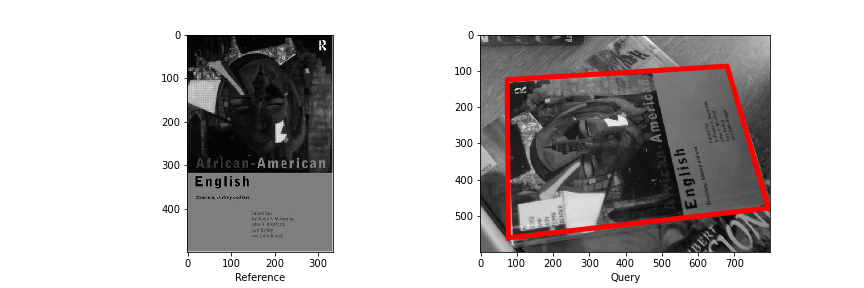![Books](book.png "Books")

0. Download and read through the paper [ORB: an efficient alternative to SIFT or SURF](https://www.researchgate.net/publication/221111151_ORB_an_efficient_alternative_to_SIFT_or_SURF) by Rublee et al. You don't need to understand all the details, but try to get an idea of how it works. ORB combines the FAST corner detector (covered in week 3) and the BRIEF descriptor. BRIEF is based on similar ideas to the SIFT descriptor we covered week 3, but with some changes for efficiency.

1. [Load images] Load the first (reference, query) image pair from the "book_covers" category using opencv (e.g. `img=cv2.imread()`). Check the parameter option in "
cv2.imread()" to ensure that you read the gray scale image, since it is necessary for computing ORB features.

2. [Detect features] Create opencv ORB feature extractor by `orb=cv2.ORB_create()`. Then you can detect keypoints by `kp = orb.detect(img,None)`, and compute descriptors by `kp, des = orb.compute(img, kp)`. You need to do this for each image, and then you can use `cv2.drawKeypoints()` for visualization. SURF, FAST, SIFT are all possible choices for detecting keypoints and compute the features.

3. [Match features] As ORB is a binary feature, you need to use HAMMING distance for matching, e.g., `bf = cv2.BFMatcher(cv2.NORM_HAMMING)`. Then you are requried to do KNN matching (k=2) by using `bf.knnMatch()`. After that, you are required to use "ratio_test" to find good matches. By default, you can set `ratio=0.8`. Note that other matching algorithm can be used to match the feature. Ratio-test is also one possible solution for filtering out the outliers. You can choose other ways.

4. [Plot and analyze] You need to visualize the matches by using the `cv2.drawMatches()` function. Also you can change the ratio values, parameters in `cv2.ORB_create()`, and distance functions in `cv2.BFMatcher()`. Please discuss how these changes influence the match numbers. Please make at least two changes.


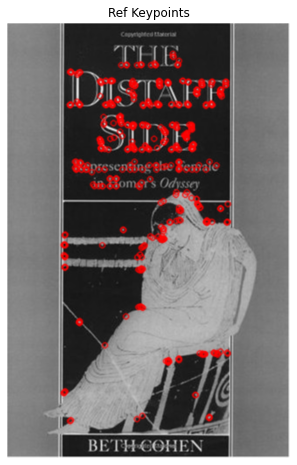

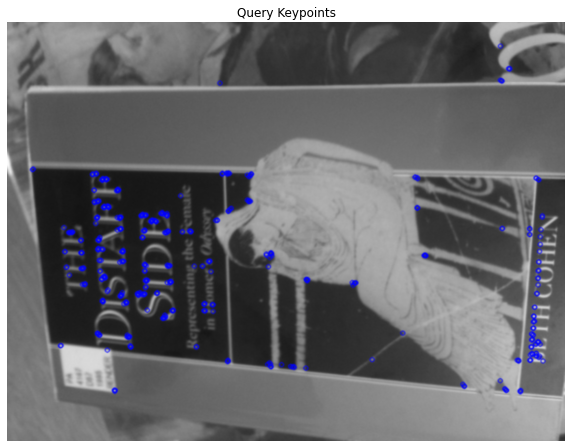

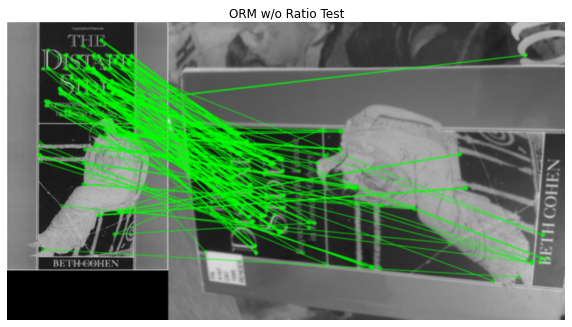

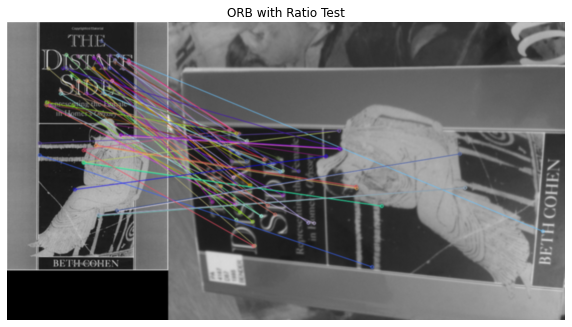

In [4]:
# load image at gray scale
refernce_file_path = "/Users/ishan/Downloads/Tri-Sem-2/Computer Vision/Assignments/A2/A2_smvs/book_covers/Reference/001.jpg"
query_file_path = "/Users/ishan/Downloads/Tri-Sem-2/Computer Vision/Assignments/A2/A2_smvs/book_covers/Query/001.jpg"

query_img = readImage(query_file_path)
reference_img = readImage(refernce_file_path)

# compute detector and descriptor
orb = getORB_Object()

# find the keypoints and descriptors with ORB
query_kp, query_desc = orb.detectAndCompute(query_img, None)
ref_kp, ref_desc = orb.detectAndCompute(reference_img, None)

# draw keypoints
query_kp_output=cv2.drawKeypoints(query_img,query_kp,None,color=(0,0,255),flags=0)
ref_kp_output =cv2.drawKeypoints(reference_img,ref_kp,None,color=(255,0,0),flags=0)
displayImage(ref_kp_output,'Ref Keypoints')
displayImage(query_kp_output,'Query Keypoints')

# create BFMatcher object
# Next we create a BFMatcher object with distance measurement cv.NORM_HAMMING 
# (since we are using ORB) and crossCheck is switched on for better results
bf = getBFMatcherObj(norm = cv2.NORM_HAMMING)

# Match descriptors.
matches = bf.match(ref_desc,query_desc)
matches = sorted(matches, key = lambda x:x.distance)
result = cv2.drawMatches(reference_img,ref_kp,query_img,query_kp,matches,None,matchColor=[0,255,0], flags=2)
displayImage(result, 'ORM w/o Ratio Test')

#Knn Matching 
bf_knn = cv2.BFMatcher()
knn_matches = bf_knn.knnMatch(ref_desc,query_desc,k=2)

# Apply ratio test
ratio = 0.8
required_matches = applyRatioTest(knn_matches, ratio)

# draw matches
result_ratio_test = cv2.drawMatchesKnn(reference_img,ref_kp,query_img,query_kp,required_matches,None,flags=2)

displayImage(result_ratio_test, 'ORB with Ratio Test')

#Change two parameters and discuss the output



#### Changing BFMatcher with different NORM Types (Distance Calcualtion)

In [5]:
#BFMatcher with different NORM Types
# bf_nh2 = getBFMatcherObj(norm = cv2.NORM_HAMMING2)
bf_nh = getBFMatcherObj(norm = cv2.NORM_HAMMING)
bf_l2 = getBFMatcherObj(norm = cv2.NORM_L2)
bf_l1 = getBFMatcherObj(norm = cv2.NORM_L1)

bfmatcher_list = [bf_nh,bf_l2,bf_l1]
bf_label = ['BFMatcher with NORM_HAMMING',
            'BFMatcher with NORM_L2','BFMatcher with NORM_L1']

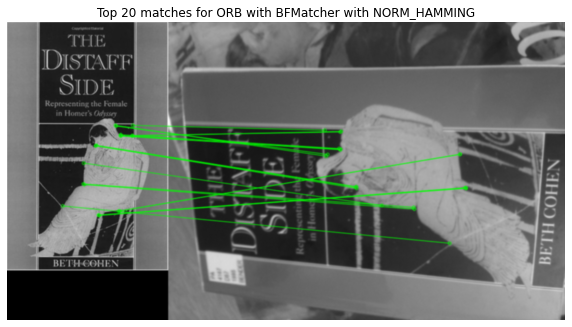

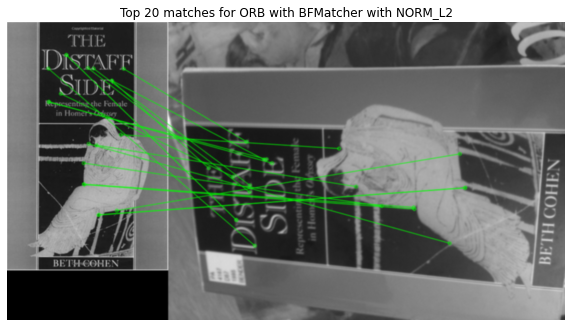

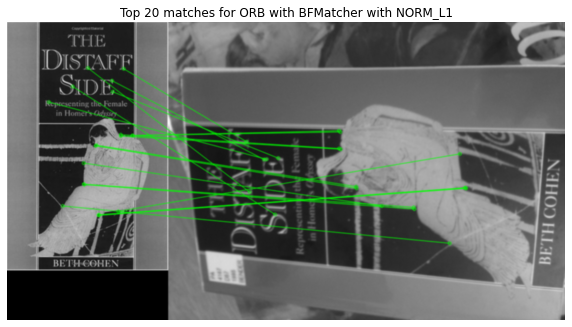

In [6]:
result_bf_Matcher = changeBFMacther(query_img, reference_img, bfmatcher_list, n = 20)

for key in result_bf_Matcher :
    displayImage(result_bf_Matcher[key], 'Top 20 matches for ORB with {}'.format(bf_label[key]))


#### Changing Ratio

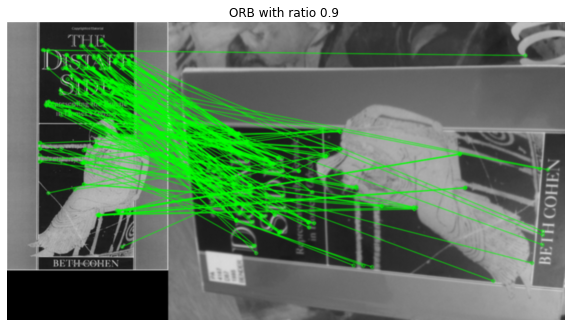

In [7]:
#Chaning Ratio  to 0.9
ratio_list = [0.9,0.7,0.5]
current_ratio_index = 0

result_ratio_list_1 = changeRatio(query_img, reference_img, ratio_list[current_ratio_index], [cv2.BFMatcher()])

for key in result_ratio_list_1 :
    displayImage(result_ratio_list_1[key], 'ORB with ratio {} '.format(str(ratio_list[current_ratio_index])))


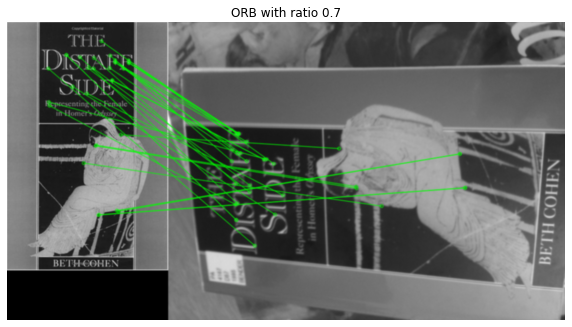

In [8]:
#Chaning Ratio  to 0.7
current_ratio_index = 1
result_ratio_list_2 = changeRatio(query_img, reference_img, ratio_list[current_ratio_index], [cv2.BFMatcher()])

for key in result_ratio_list_2 :
    displayImage(result_ratio_list_2[key], 'ORB with ratio {}'.format(str(ratio_list[current_ratio_index])))


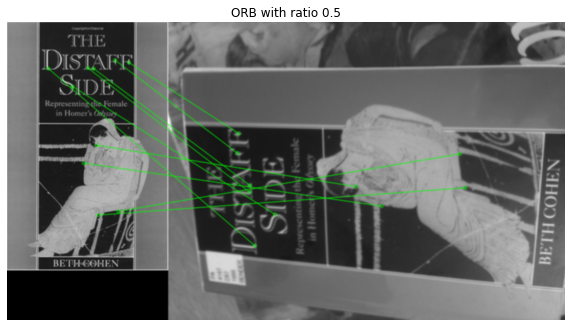

In [9]:
#Chaning Ratio  to 0.5
current_ratio_index = 2
result_ratio_list_3 = changeRatio(query_img, reference_img, ratio_list[current_ratio_index], [cv2.BFMatcher()])
for key in result_ratio_list_3 :
    displayImage(result_ratio_list_3[key], 'ORB with ratio {}'.format(str(ratio_list[current_ratio_index])))


#### Changing FastThreshold

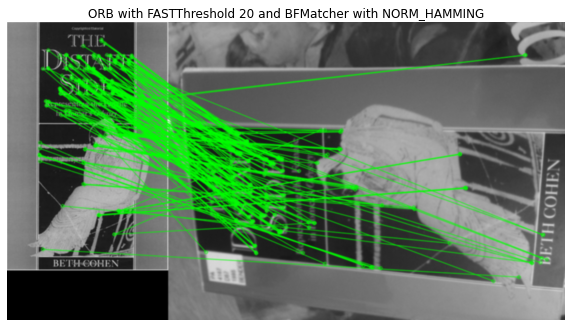

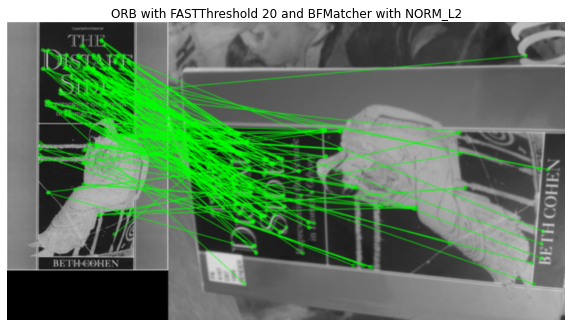

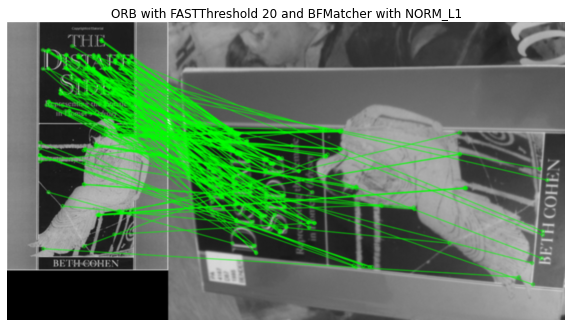

In [10]:
#Changing FastThreshold to 20
thershold_list = [20,40,120]

current_threshold_index = 0
result_threshold_list_1 = changeFastThreshold(query_img, reference_img, thershold_list[current_threshold_index], bfmatcher_list)

for key in result_threshold_list_1 :
    displayImage(result_threshold_list_1[key], 'ORB with FASTThreshold {} and {}'.format(str(thershold_list[current_threshold_index]),bf_label[key]))


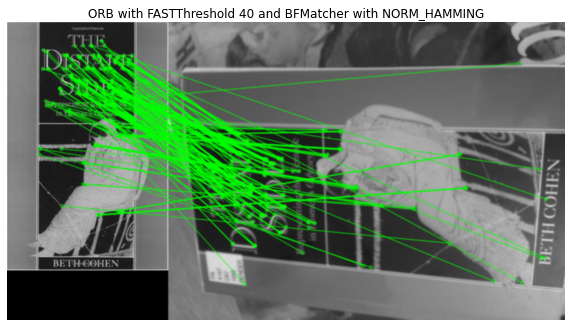

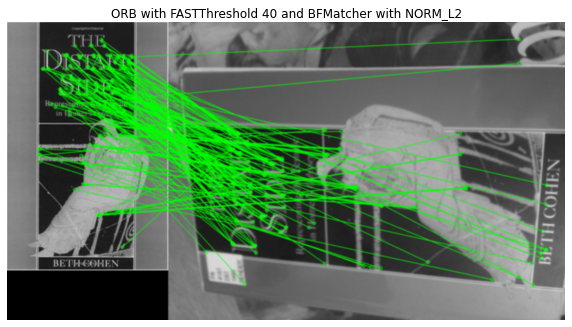

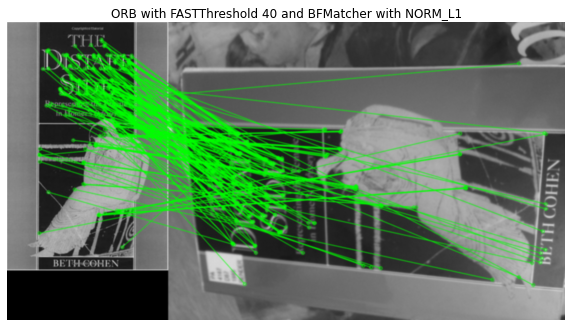

In [11]:
#Changing FastTHreshold to 40
current_threshold_index = 1
result_threshold_list_1 = changeFastThreshold(query_img, reference_img, thershold_list[current_threshold_index], bfmatcher_list)

for key in result_threshold_list_1 :
    displayImage(result_threshold_list_1[key], 'ORB with FASTThreshold {} and {}'.format(str(thershold_list[current_threshold_index]),bf_label[key]))


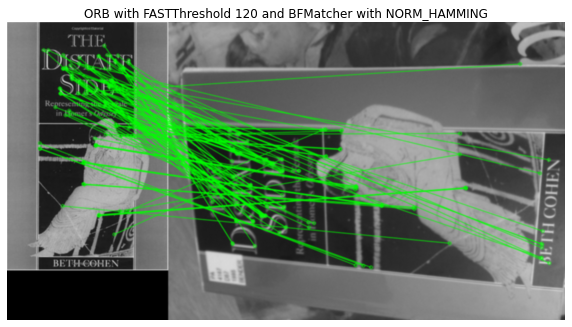

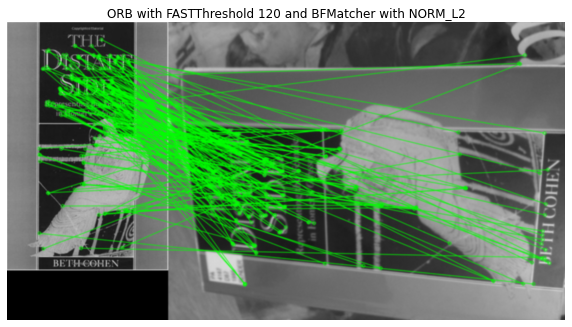

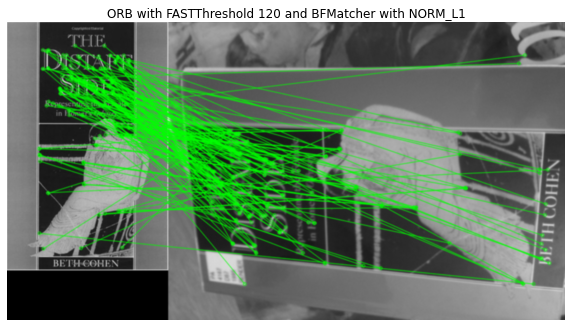

In [12]:
#Changing FastTHreshold to 120
current_threshold_index = 2
result_threshold_list_1 = changeFastThreshold(query_img, reference_img, thershold_list[current_threshold_index], bfmatcher_list)

for key in result_threshold_list_1 :
    displayImage(result_threshold_list_1[key], 'ORB with FASTThreshold {} and {}'.format(str(thershold_list[current_threshold_index]),bf_label[key]))


#### Changing n level in ORB Object

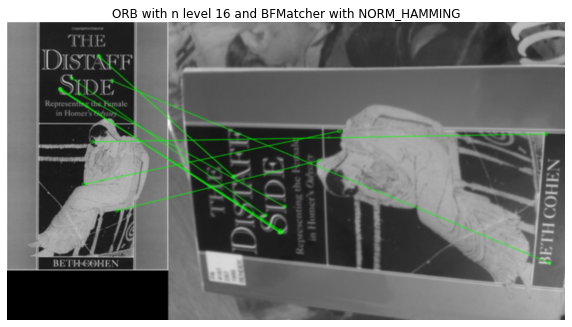

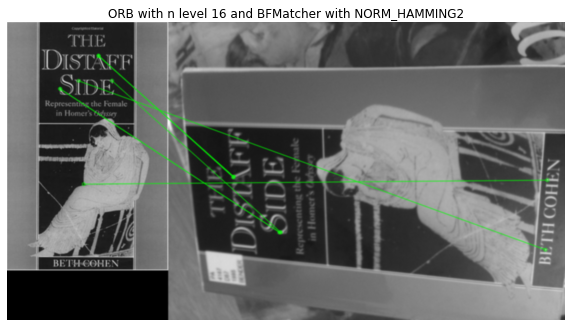

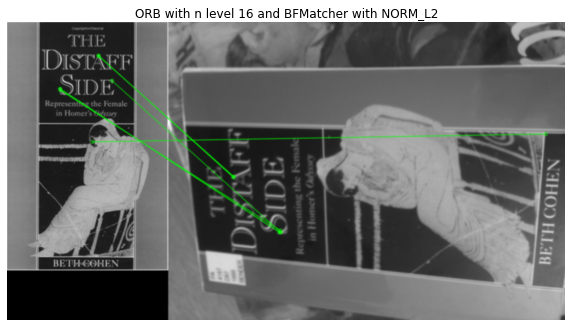

In [13]:
#Changing N_levels to 16
bf_label = ['BFMatcher with NORM_HAMMING','BFMatcher with NORM_HAMMING2',
            'BFMatcher with NORM_L2','BFMatcher with NORM_L1']
n_levels = [16,24,32]

index_n_level = 0
results_n_level_16 =  assignDifferent_n_levels(query_img, reference_img, n_levels[index_n_level], [bf_nh,bf_l2,bf_l1])

for key in results_n_level_16 :
    displayImage(results_n_level_16[key], 'ORB with n level {} and {}'.format(str(n_levels[index_n_level]),bf_label[key]))


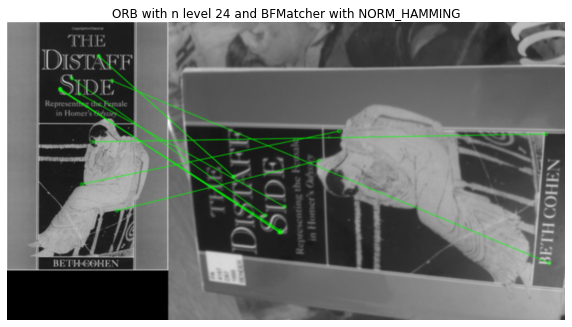

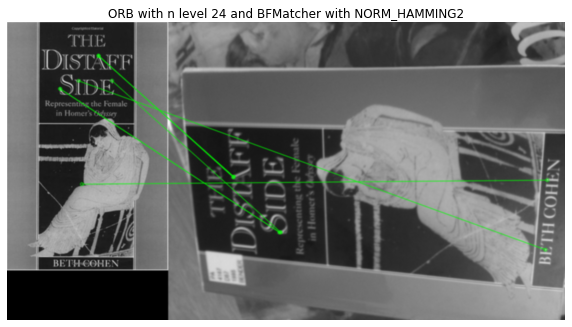

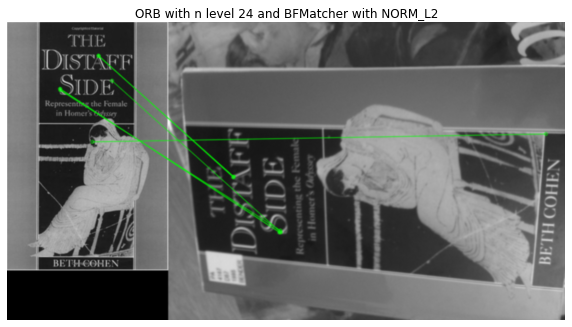

In [14]:
#Changing N_levels to 24
index_n_level = 1
results_n_level_24 =  assignDifferent_n_levels(query_img, reference_img, n_levels[index_n_level], [bf_nh,bf_l2,bf_l1])

for key in results_n_level_24 :
    displayImage(results_n_level_24[key], 'ORB with n level {} and {}'.format(str(n_levels[index_n_level]),bf_label[key]))


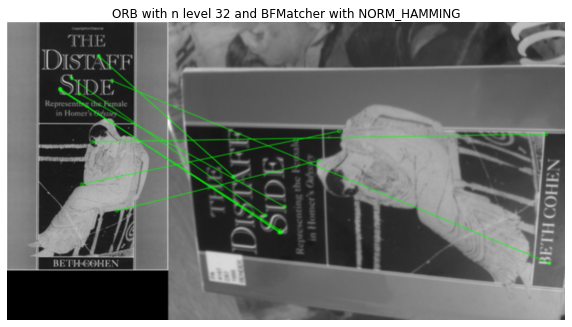

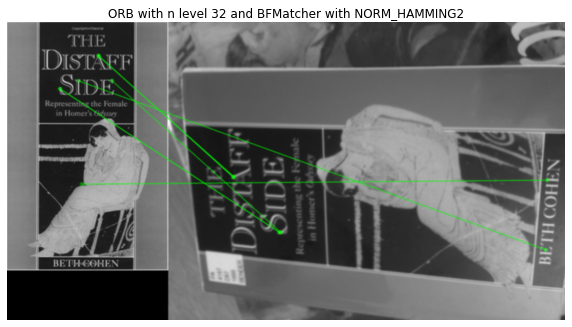

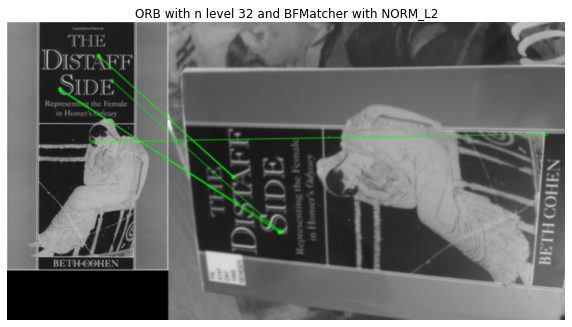

In [15]:
#Changing N_levels to 32
index_n_level = 2
results_n_level_32 =  assignDifferent_n_levels(query_img, reference_img, n_levels[index_n_level], [bf_nh,bf_l2,bf_l1])

for key in results_n_level_32 :
    displayImage(results_n_level_32[key], 'ORB with n level {} and {}'.format(str(n_levels[index_n_level]),bf_label[key]))


## Different Approaches
Following approaches where attempted to see the changes in Feature matching apporoach
1. Changing the NORM Type (Diatance Calculation) in BFMatcher method
2. Varying the ratio for BFMatcher's knn approach
3. Varying the FastThreshold of the ORB object
4. Varying the n_levels while creating the ORB object

## Observations
As per the instruction only visual changes are observed and analysed.

1. Changing the NORM Type (Diatance Calculation) in BFMatcher method - Different distance calculation approaches were used for calculation the similarity of feature like HAMMING, L2 and L1. Only top 20 macthes are selected to compare the results. It can be seen that the features mapped using the NORM_HAMMING is more accurate than the other two approaches for distance calcualtion. It is due to the fac that ORB is a binary descriptor, which essentially works best with the NORM HAMMING 

2. Varying the ratio for BFMatcher's knn approach - bf.knnMatch is used for this approach. As the ratio are reduced from 0.9 to 0.5, the number of good matches drop down significanlty. This is becase as we decrease the ratio the number of good quality matches reduces as well due to implementation of Lowe's Ratio test. This test checks if distance of the macthes for two neighbours are within a certain ratio which works are the 'quality' parameter.

3. Varying the FastThreshold of the ORB Object - Since ORB uses Fast(Features from Accelerated and Segments Test) the threshold value, t,  is essentialy the value uses to asses if a particular pixel of intereset is a feature point or not by calculting the t + ip (intensity of the intersed pixel) and t - ip for a circle around the interested pixel. The pixel on the circle should be either brighter or darker than t + ip or t - ip restpectively. As it can be seen as we increase the threshold we increase the requirement for neighbouring pixel to more brighter or darker than the condition used for FAST, which essentailly mean lesser number pixels will qualify as a feature point. It can be seen from the above output as the threshold increases the number of matches drops.

3. Have a look on the document of "cv2.findHomography()". Estimate a homography transformation based on the matches using "least squares method". Display the transformed outline of the first reference book cover image on the query image.

    - We provide a function `draw_outline()` to help with the display, but you may need to edit it for your needs.
    - Try the 'least squre method' option to compute homography, and visualize the inliers by using `cv2.drawMatches()`. Explain your results.
    - Again, you don't need to compare results numerically at this stage. Comment on what you observe visually.

In [16]:
def getOutlineNumber(matchesMask):
    count = 0
    for item in matchesMask.ravel().tolist():
        if(item == 0):
            count +=1
    return count


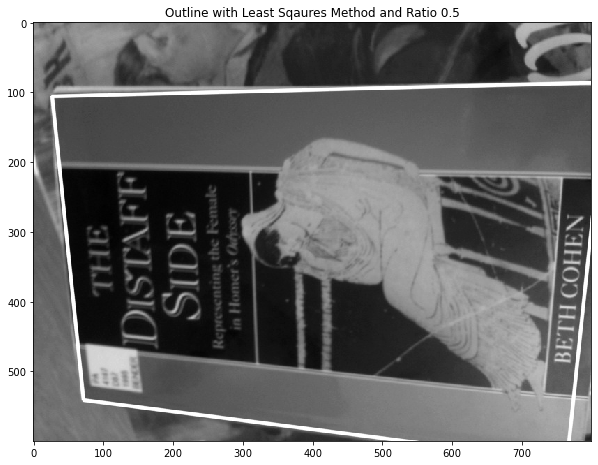

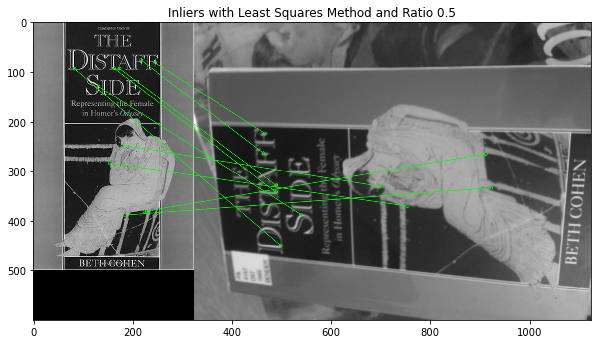

Total number of Inliers are  None


In [17]:
# Your code to display book location here
orb = getORB_Object()

query_kp_, ref_kp_, matches_1, result = FeatureMatchingPipeline(query_img, reference_img, orb, cv2.BFMatcher(), True, ratio = 0.5, n = 1000)

matches_list = []
for item_list in matches_1:
    matches_list.append(item_list[0])

# using regular method
model, matchesMask = performHomoGraphy(query_kp_,ref_kp_, matches_list) 

# draw frame
draw_outline(reference_img,query_img, model, 'Outline with Least Sqaures Method and Ratio 0.5')

# draw inliers
draw_inliers(reference_img, query_img,ref_kp_,query_kp_,matches_list, matchesMask, 'Inliers with Least Squares Method and Ratio 0.5')

print('Total number of Inliers are ', getInlierNumber(matchesMask))

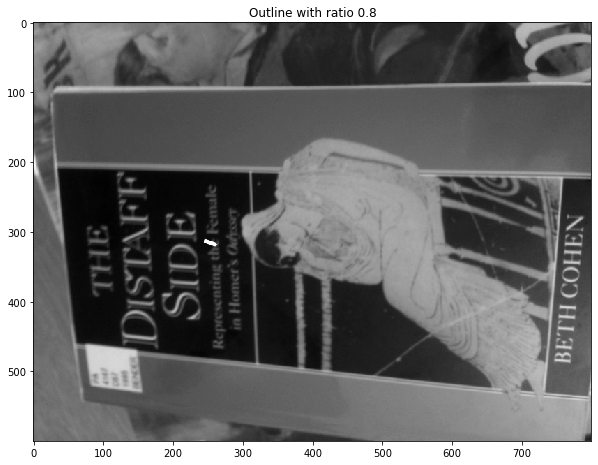

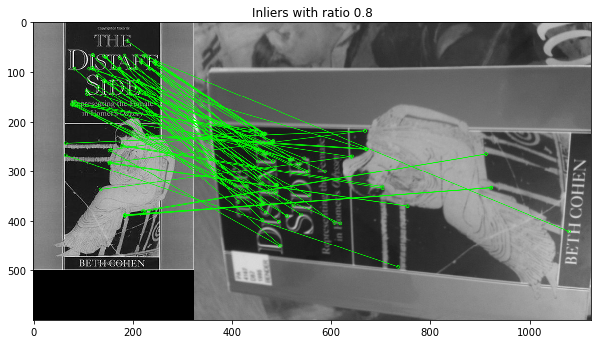

Total number of Inliers are  None


In [18]:
# Your code to display book location here
orb = getORB_Object()

query_kp_ratio, ref_kp_ratio, matches_ratio, result_ratio = FeatureMatchingPipeline(query_img, reference_img, orb, cv2.BFMatcher(), True, ratio = 0.8, n = 1000)

matches_list_ratio = []
for item_list in matches_ratio:
    matches_list_ratio.append(item_list[0])

# using regular method
model_ratio, matchesMask_ratio = performHomoGraphy(query_kp_ratio,ref_kp_ratio, matches_list_ratio) 

# draw frame
draw_outline(reference_img,query_img, model_ratio, 'Outline with ratio 0.8')

# draw inliers
draw_inliers(reference_img, query_img,ref_kp_ratio,query_kp_ratio,matches_list_ratio, matchesMask_ratio, 'Inliers with ratio 0.8')
print('Total number of Inliers are ', getInlierNumber(matchesMask_ratio))

## Explanation
Homography is a matrix that maps coordinates from one plane to the same plane that has been rotated (translated/transformed) in any other way in space. In this project homography is perfomred cv2.findHomography. It is used with  Lowe's ration test with ratio 0.5 and 0.8. As it can be seen from the above images the ratio with 0.5 produces a better bounding box in the query  Image that the ration 0.8. However, the ratio 0.8 gives a better number of Inliers.

4. Try the RANSAC option to compute homography. Change the RANSAC parameters, and explain your results. Print and analyze the inlier numbers.

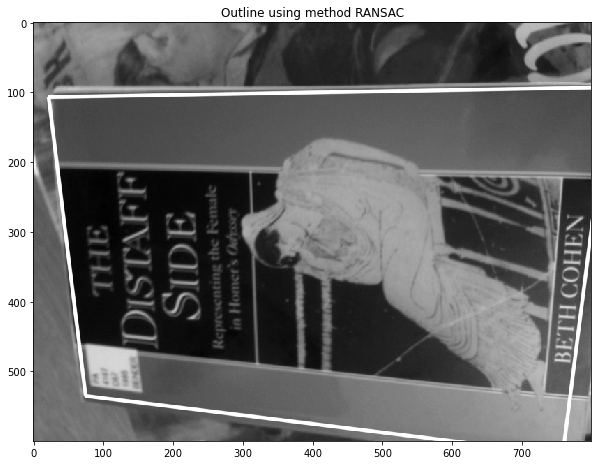

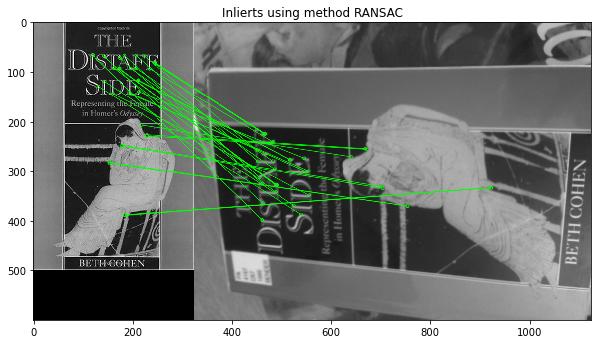

Total number of Inliers for RNASAC are  None


In [19]:
#RANSAC with Default Threshold
homography_method_list = [None, cv2.RANSAC, cv2.LMEDS, cv2.RHO]

query_kp_ransac, ref_kp_ransac, matches_list_ransac = prepareForHomoGraphy(query_img, reference_img)

model_ransac, matchesMask_ransac = performHomoGraphy(query_kp_ransac, ref_kp_ransac, matches_list_ransac, homography_method_list[1])

# draw frame
draw_outline(reference_img,query_img, model_ransac, 'Outline using method RANSAC')

# draw inliers
draw_inliers(reference_img,query_img,ref_kp_ransac,query_kp_ransac,matches_list_ransac, matchesMask_ransac, 'Inlierts using method RANSAC')

# inlier number
print('Total number of Inliers for RNASAC are ', getInlierNumber(matchesMask_ransac))

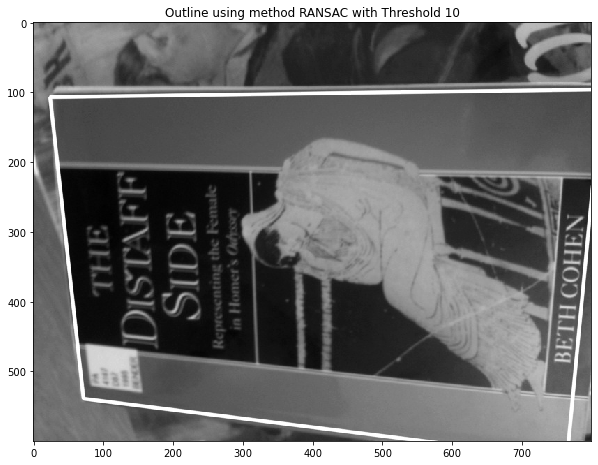

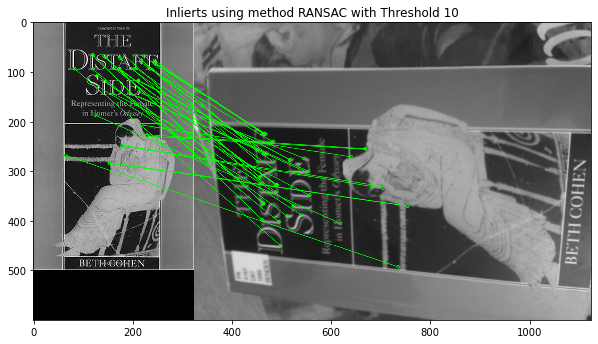

Total number of Inliers for RNASAC with Threshold 10 are  None


In [20]:
#RANSAC with  Threshold = 10
homography_method_list = [None, cv2.RANSAC, cv2.LMEDS, cv2.RHO]

query_kp_ransac_10, ref_kp_ransac_10, matches_list_ransac_10 = prepareForHomoGraphy(query_img, reference_img)

model_ransac_10, matchesMask_ransac_10 = performHomoGraphy(query_kp_ransac_10, ref_kp_ransac_10, matches_list_ransac_10, homography_method_list[1], 10)

# draw frame
draw_outline(reference_img,query_img, model_ransac_10, 'Outline using method RANSAC with Threshold 10')

# draw inliers
draw_inliers(reference_img,query_img,ref_kp_ransac_10,query_kp_ransac_10,matches_list_ransac_10, matchesMask_ransac_10, 'Inlierts using method RANSAC with Threshold 10')

# inlier number
print('Total number of Inliers for RNASAC with Threshold 10 are ', getInlierNumber(matchesMask_ransac_10))

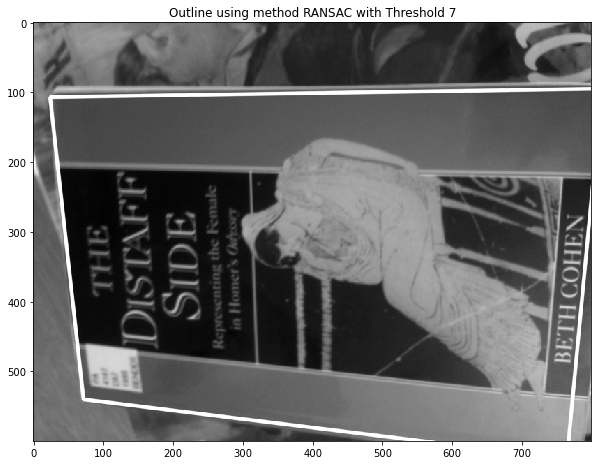

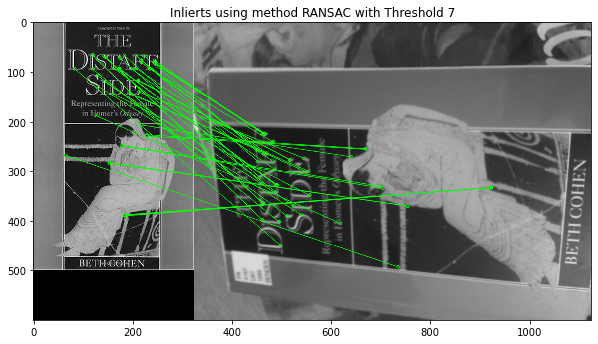

Total number of Inliers for RNASAC are  None


In [21]:
#RANSAC with  Threshold = 5
homography_method_list = [None, cv2.RANSAC, cv2.LMEDS, cv2.RHO]

query_kp_ransac_15, ref_kp_ransac_15, matches_list_ransac_15 = prepareForHomoGraphy(query_img, reference_img)

model_ransac_15, matchesMask_ransac_15 = performHomoGraphy(query_kp_ransac_15, ref_kp_ransac_15, matches_list_ransac_15, homography_method_list[1], 5)

# draw frame
draw_outline(reference_img,query_img, model_ransac_15, 'Outline using method RANSAC with Threshold 7')

# draw inliers
draw_inliers(reference_img,query_img,ref_kp_ransac_15,query_kp_ransac_15,matches_list_ransac_15, matchesMask_ransac_15, 'Inlierts using method RANSAC with Threshold 7')

# inlier number
print('Total number of Inliers for RNASAC are ', getInlierNumber(matchesMask_ransac_15))

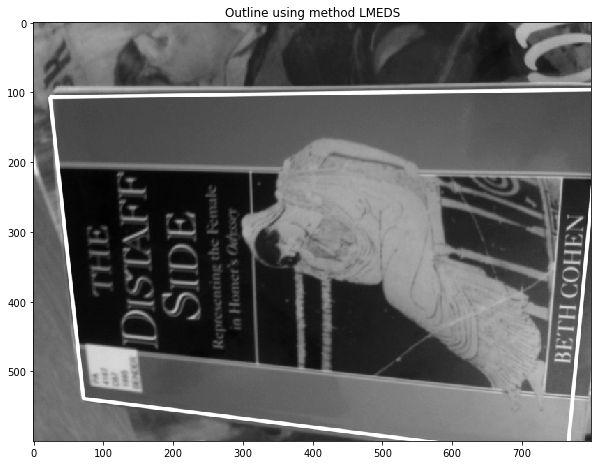

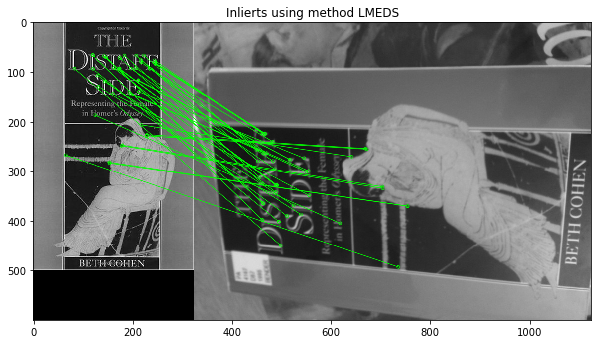

Total number of Inliers for LMEDS are  None


In [22]:
# Using method LMEDS
query_kp_lmeds, ref_kp_lmeds, matches_list_lmeds = prepareForHomoGraphy(query_img, reference_img)

model_lmeds, matchesMask_lmeds = performHomoGraphy(query_kp_lmeds, ref_kp_lmeds, matches_list_lmeds, homography_method_list[2])

# draw frame
draw_outline(reference_img,query_img, model_lmeds, 'Outline using method LMEDS')

# draw inliers
draw_inliers(reference_img,query_img,ref_kp_lmeds,query_kp_lmeds,matches_list_lmeds, matchesMask_lmeds, 'Inlierts using method LMEDS')

# inlier number
print('Total number of Inliers for LMEDS are ', getInlierNumber(matchesMask_lmeds))

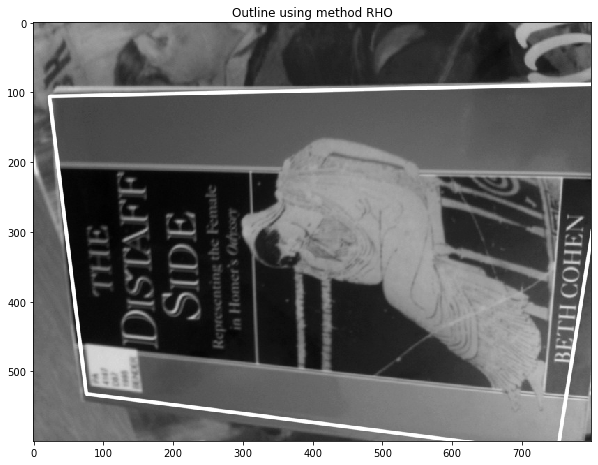

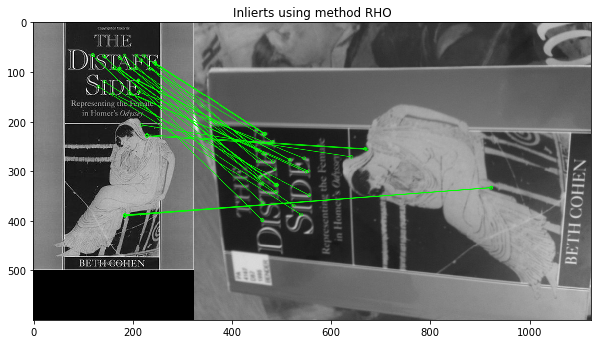

Total number of Inliers for RHO are  None


In [23]:
# Using method RHO
query_kp_rho, ref_kp_rho, matches_list_rho = prepareForHomoGraphy(query_img, reference_img)

model_rho, matchesMask_rho = performHomoGraphy(query_kp_rho, ref_kp_rho, matches_list_rho, homography_method_list[3])

# draw frame
draw_outline(reference_img,query_img, model_rho, 'Outline using method RHO')

# draw inliers
draw_inliers(reference_img,query_img,ref_kp_rho,query_kp_rho,matches_list_rho, matchesMask_rho, 'Inlierts using method RHO')

# inlier number
print('Total number of Inliers for RHO are ', getInlierNumber(matchesMask_rho))
        

## Explanation and Oberservations
Random sample consensus (RANSAC) is an iterative method which has the abilit to estimate the parameters with a high degree of accuracy with significant number of outliers. It chooses four random keypints and calculate a homography and counts the number of inliers. This kept until a better homography is found. It can be seen from the above output the RANSAC approach showcases the lowest number of inliers (with default threshold) due to it's robust nature as compared to other method like LMEDS and RHO.

It can also be seen that the number of inliers increase as the Threshold is increased. This is to be expected as the the threshold determines the wether to treate a pair as an inlier. It can also be seen that the bonding box on the query image for RANSAC with threshold 5 and above is better than the default threshold. Although, the bounding boxes for LMEDS and RHO are also better than the RANSAC with threshold < 3.




6. Finally, try matching several different image pairs from the data provided, including at least one success and one failure case. For the failure case, test and explain what step in the feature matching has failed, and try to improve it. Display and discuss your findings.
    1. Hint 1: In general, the book covers should be the easiest to match, while the landmarks are the hardest.
    2. Hint 2: Explain why you chose each example shown, and what parameter settings were used.
    3. Hint 3: Possible failure points include the feature detector, the feature descriptor, the matching strategy, or a combination of these.

In [24]:
def getListofImages(file_path, start_end_index, isQuery = False):
    image_list = []
    if(isQuery):
        count = 1
    else:
        count = 0
        
    for i in range(start_end_index[0],start_end_index[1]):
        if(i < 10):
            image_path = file_path + '00' + str(i + count) + '.jpg'
        else:
            image_path = file_path + '0' + str(i + count) + '.jpg'
        img = readImage(image_path)
        image_list.append(img)      
    return image_list

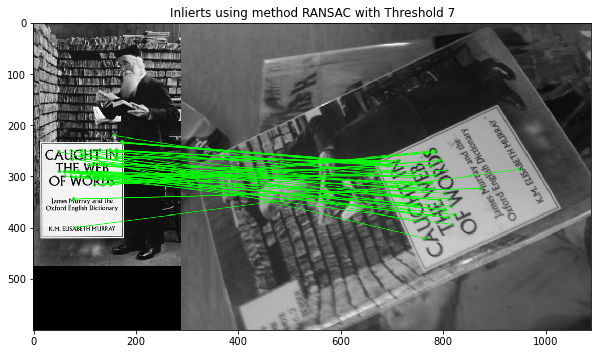

Total number of Inliers in original Reference and Query  None


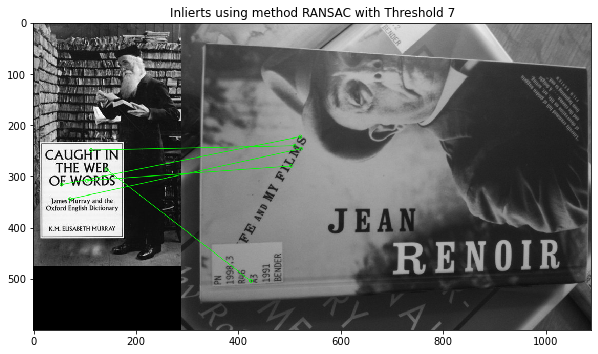

Total number of Inliers in same Reference but different Query None


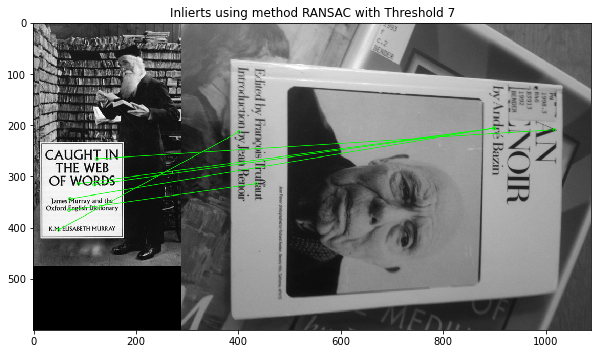

Total number of Inliers in same Reference but different Query None


In [25]:
book_refernce_file_path = "/Users/ishan/Downloads/Tri-Sem-2/Computer Vision/Assignments/A2/A2_smvs/book_covers/Reference/"
book_query_file_path = "/Users/ishan/Downloads/Tri-Sem-2/Computer Vision/Assignments/A2/A2_smvs/book_covers/Query/"

book_reference_path_list = getListofImages(book_refernce_file_path, (10,12))
book_query_img = readImage("/Users/ishan/Downloads/Tri-Sem-2/Computer Vision/Assignments/A2/A2_smvs/book_covers/Query/010.jpg")
book_query_path_list = getListofImages(book_query_file_path, (10,12), True)

book_query_orignial_kp, book_ref_orignial_kp, book_matches_orignial_kp = prepareForHomoGraphy(book_query_img, book_reference_path_list[0])
model_ransac_orignial_kp, matchesMask_ransac_orignial_kp = performHomoGraphy(book_query_orignial_kp, book_ref_orignial_kp, book_matches_orignial_kp, homography_method_list[1], 5)

draw_inliers(book_reference_path_list[0],book_query_img,book_ref_orignial_kp,book_query_orignial_kp,book_matches_orignial_kp, matchesMask_ransac_orignial_kp, 'Inlierts using method RANSAC with Threshold 7')

# inlier number
print('Total number of Inliers in original Reference and Query ', getInlierNumber(matchesMask_ransac_orignial_kp))

for index in range(0, len(book_reference_path_list)):
    book_query_kp, book_ref_kp, book_matches = prepareForHomoGraphy(book_query_path_list[index], book_reference_path_list[0])
    model_book_ransac, matchesMask_book_ransac = performHomoGraphy(book_query_kp, book_ref_kp, book_matches, homography_method_list[1], 5)
# draw inliers
    draw_inliers(book_reference_path_list[0],book_query_path_list[index],book_ref_kp,book_query_kp,book_matches, matchesMask_book_ransac, 'Inlierts using method RANSAC with Threshold 7')
    print('Total number of Inliers in same Reference but different Query', getInlierNumber(matchesMask_book_ransac))





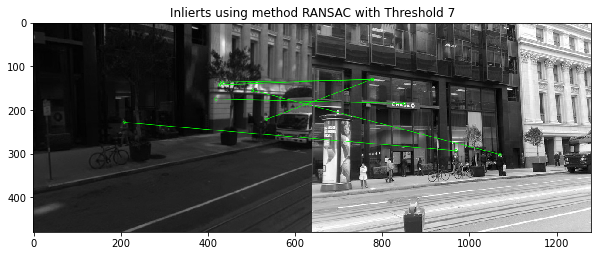

Total number of Inliers in original Reference and Query  None


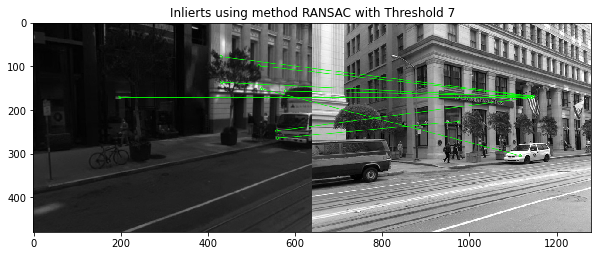

Total number of Inliers in same Reference but different Query None


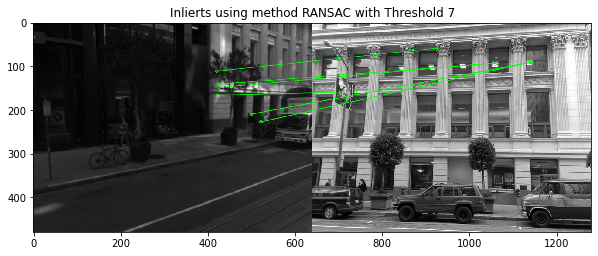

Total number of Inliers in same Reference but different Query None


In [26]:
landmarks_refernce_file_path = "/Users/ishan/Downloads/Tri-Sem-2/Computer Vision/Assignments/A2/A2_smvs/landmarks/Reference/"
landmarks_query_file_path = "/Users/ishan/Downloads/Tri-Sem-2/Computer Vision/Assignments/A2/A2_smvs/landmarks/Query/"

landmarks_reference_path_list = getListofImages(landmarks_refernce_file_path, (10,20))
landmark_query_image = readImage("/Users/ishan/Downloads/Tri-Sem-2/Computer Vision/Assignments/A2/A2_smvs/landmarks/Query/010.jpg")
landmarks_query_path_list = getListofImages(landmarks_query_file_path, (10,20), True)


landmark_query_orignial_kp, landmark_ref_orignial_kp, landmark_matches_orignial = prepareForHomoGraphy(landmark_query_image, landmarks_reference_path_list[0])
model_landmark, matchesMask_landmark_orignial = performHomoGraphy(landmark_query_orignial_kp, landmark_ref_orignial_kp, landmark_matches_orignial, homography_method_list[1], 5)

draw_inliers(landmarks_reference_path_list[0],landmark_query_image,landmark_ref_orignial_kp,landmark_query_orignial_kp,landmark_matches_orignial, matchesMask_landmark_orignial, 'Inlierts using method RANSAC with Threshold 7')

# inlier number
print('Total number of Inliers in original Reference and Query ', getInlierNumber(matchesMask_ransac_orignial_kp))

for index in range(0, len(book_reference_path_list)):
    landmark_query_kp, landmark_ref_kp, landmark_matches = prepareForHomoGraphy(landmarks_query_path_list[index], landmarks_reference_path_list[0])
    model_landmark_ransac, matchesMask_landmark__ransac = performHomoGraphy(landmark_query_kp, landmark_ref_kp, landmark_matches, homography_method_list[1], 5)
# draw inliers
    draw_inliers(landmarks_reference_path_list[0],landmarks_query_path_list[index],landmark_ref_kp,landmark_query_kp,landmark_matches, matchesMask_landmark__ransac, 'Inlierts using method RANSAC with Threshold 7')
    print('Total number of Inliers in same Reference but different Query', getInlierNumber(matchesMask_landmark__ransac))

## Explanation
The above images for set of books were choosen because of the different in orientation of the book (each query image is facing a differnt direction) and for landmarks the images were choosen due to the contrast of the images with similar strucuture/shapes.

The parameters used for the above feature matching were the defualt ORB object with ratio of 0.8. Lowe's ratio test was performed along with homography to get the best possible matching features in the reference and query images.

It can be seen from the green lines, that the matching features being represented in the original reference image but different query images are pointing at corner and keypoints which are similar in the vicinity but are different in the overall images. The same can be viewed from the the sharp drop in the number of inliers.




# Question 2: What am I looking at? (40%)


<!--One application of feature matching is image retrieval. The goal of image retrieval is, given a query image of an object, to find all images in a database containing the same object, and return the results in ranked order (like a Google search). This is a huge research area but we will implement a very basic version of the problem based on the small dataset provided.-->

In this question, the aim is to identify an "unknown" object depicted in a query image, by matching it to multiple reference images, and selecting the highest scoring match. Since we only have one reference image per object, there is at most one correct answer. This is useful for example if you want to automatically identify a book from a picture of its cover, or a painting or a geographic location from an unlabelled photograph of it.

The steps are as follows:

1. Select a set of reference images (20 images) and their corresponding query images. 

    1. Hint 1: Start with the book covers.
    3. Hing 2: This question can require a lot of computation to run from start to finish, so cache intermediate results (e.g. feature descriptors) where you can.
    
2. Choose one query image corresponding to one of your reference images. Use RANSAC to match your query image to each reference image, and count the number of inlier matches found in each case. This will be the matching score for that image.

3. Identify the query object. This is the identity of the reference image with the highest match score, or "not in dataset" if the maximum score is below a threshold.

4. Repeat steps 2-3 for every query image and report the overall accuracy of your method (that is, the percentage of query images that were correctly matched in the dataset). Discussion of results should include both overall accuracy and individual failure cases.

    1. Hint 1: In case of failure, what ranking did the actual match receive? If we used a "top-k" accuracy measure, where a match is considered correct if it appears in the top k match scores, would that change the result?



In [27]:
# def getsetOfReferenceImages(no_of_images = 20):
#     filpath = "/Users/ishan/Downloads/Tri-Sem-2/Computer Vision/Assignments/A2/A2_smvs/book_covers/Reference/"
#     set_images = []
#     for i in range(1, no_of_images + 1):
#         if(i < 10):
#             image_path = filpath + '00' + str(i) + '.jpg'
#         else:
#             image_path = filpath + '0' + str(i) + '.jpg'
#         img = readImage(image_path)
#         set_images.append(img)      
#     return set_images

# def getsetOfQueryImages(no_of_images = 100):
#     filpath = "/Users/ishan/Downloads/Tri-Sem-2/Computer Vision/Assignments/A2/A2_smvs/book_covers/Query/"
#     query_images_list = []
#     for i in range(1, no_of_images + 1):
#         if(i < 10):
#             image_path = filpath + '00' + str(i) + '.jpg'
#         else:
#             image_path = filpath + '0' + str(i) + '.jpg'
#         img = readImage(image_path)
#         query_images_list.append(img)      
#     return query_images_list


# def FeatureMachinePipeline(query_img, reference_img, matching_approach, bf, ratioTest = False):
#     query_kp, query_desc = matching_approach.detectAndCompute(query_img, None)
#     ref_kp, ref_desc = matching_approach.detectAndCompute(reference_img, None)
#     result = None
#     matches = None
#     if(ratioTest):
#         knn_matches = bf.knnMatch(query_desc,ref_desc,k=2)
#         # Apply ratio test
#         ratio = 0.8
#         matches = applyRatioTest(knn_matches, ratio)
#         result = cv2.drawMatchesKnn(query_img,query_kp,reference_img,ref_kp,matches,None,flags=2)
#     else:
#         matches = bf.match(query_desc,ref_desc)
#         result = cv2.drawMatches(query_img,query_kp,reference_img,ref_kp,matches,None,matchColor=[0,255,0],flags=2)
#     return query_kp, ref_kp, matches, result


Index with the highest Inlier match is  0 with inliers 119


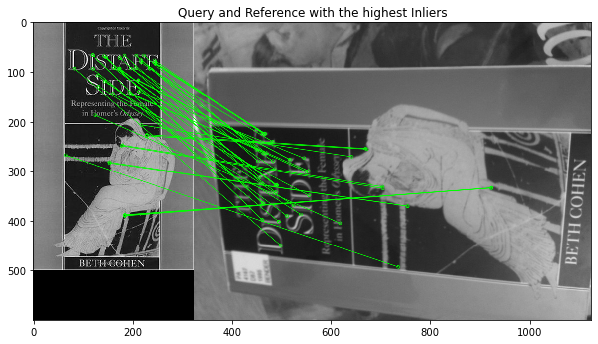

Index with the highest Inlier match is  1 with inliers 78


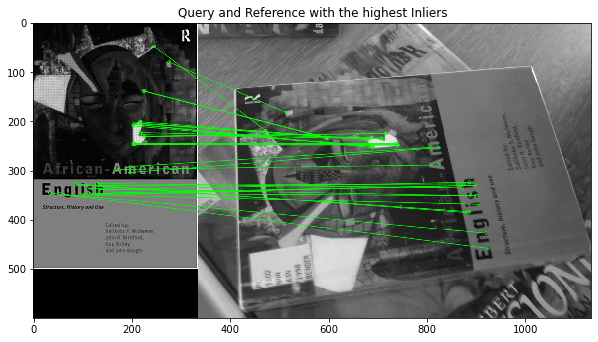

Index with the highest Inlier match is  2 with inliers 100


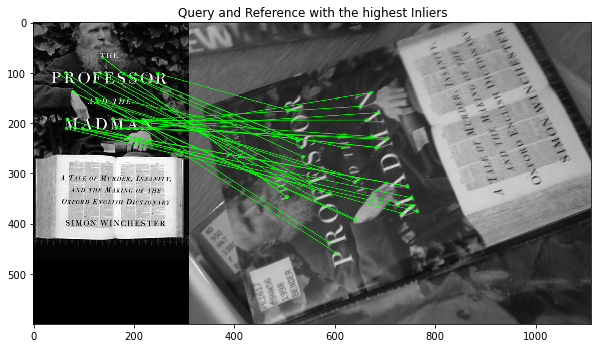

Not in Database
Not in Database
Index with the highest Inlier match is  5 with inliers 71


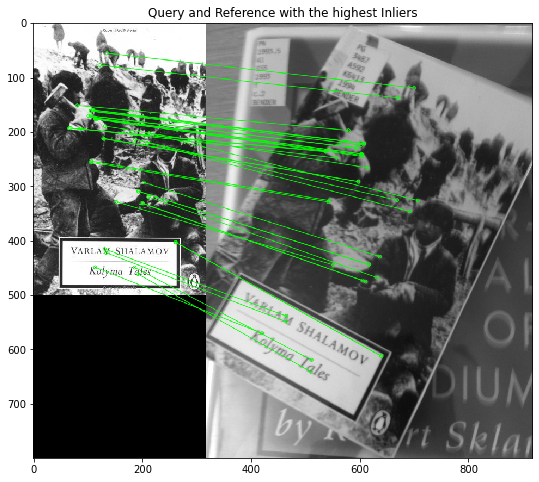

Index with the highest Inlier match is  6 with inliers 60


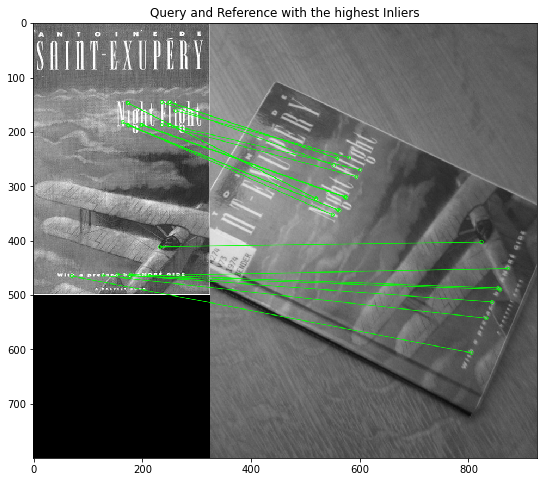

Not in Database
Index with the highest Inlier match is  8 with inliers 62


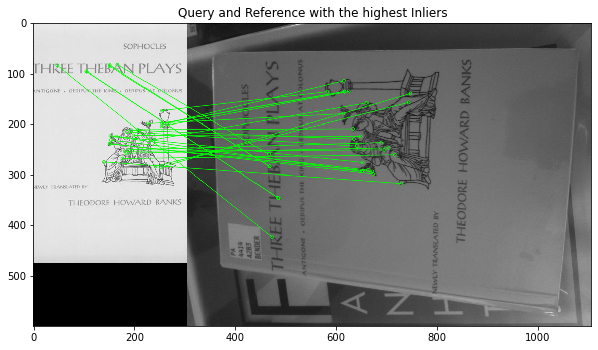

Index with the highest Inlier match is  9 with inliers 135


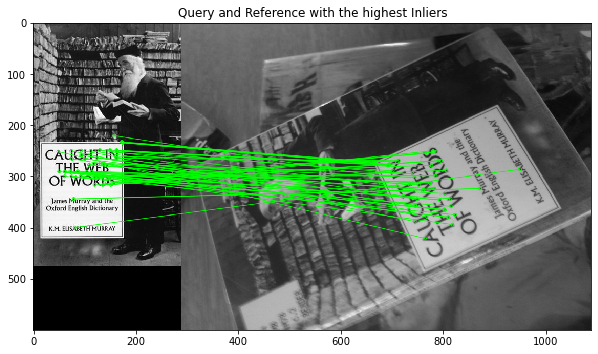

Index with the highest Inlier match is  10 with inliers 101


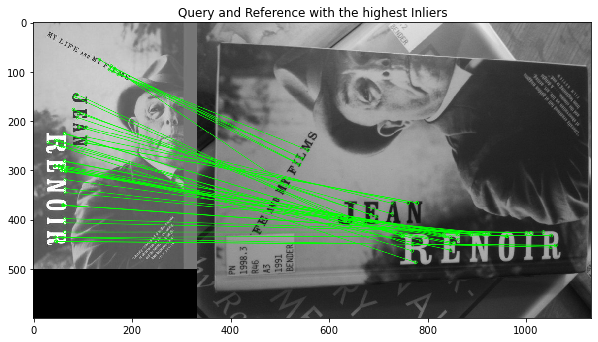

Index with the highest Inlier match is  11 with inliers 88


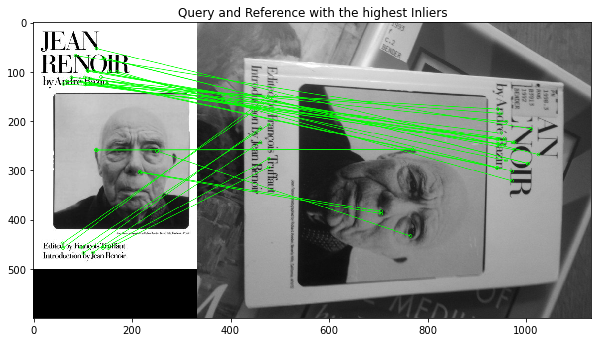

Index with the highest Inlier match is  12 with inliers 82


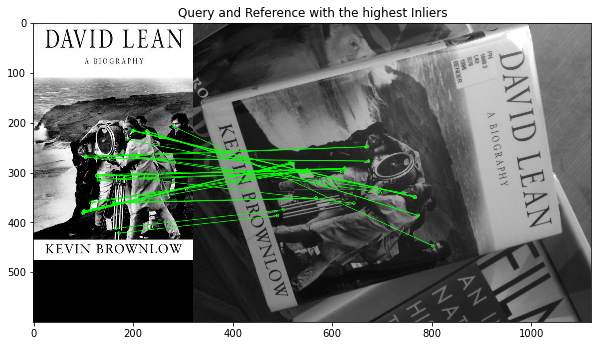

Index with the highest Inlier match is  13 with inliers 80


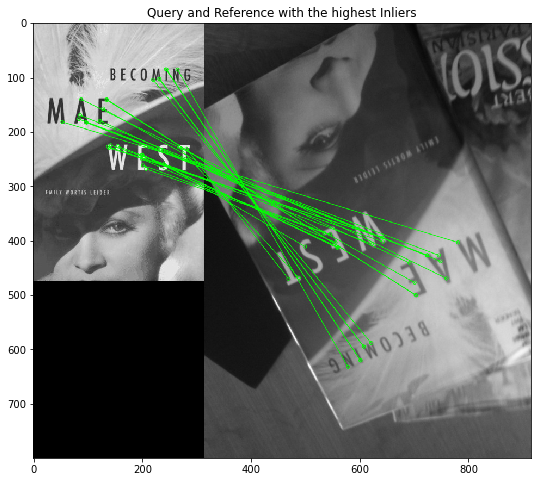

Index with the highest Inlier match is  14 with inliers 78


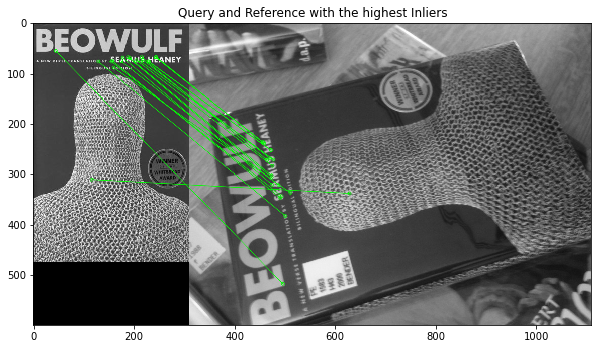

Not in Database
Index with the highest Inlier match is  16 with inliers 88


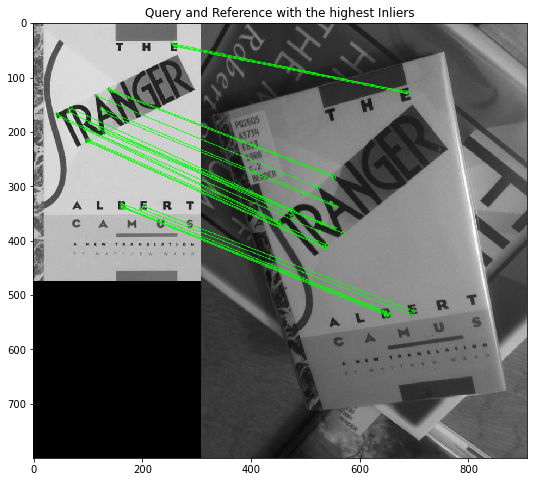

Not in Database
Index with the highest Inlier match is  18 with inliers 57


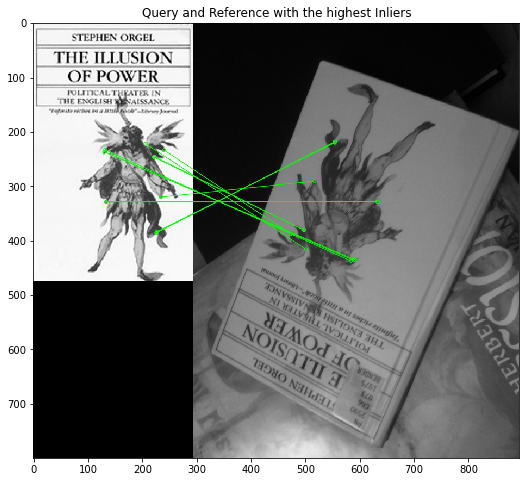

Index with the highest Inlier match is  19 with inliers 122


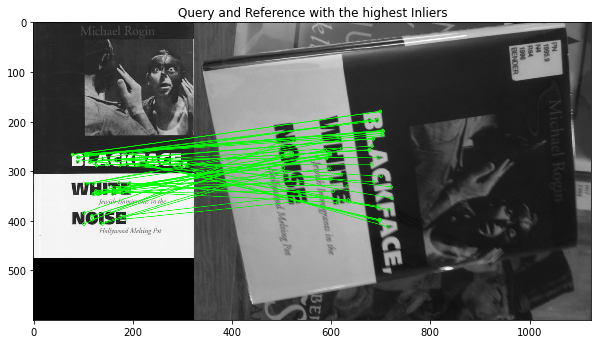

Total number of failed cases below a threshold of 50 are  5


In [28]:
query_file_path = "/Users/ishan/Downloads/Tri-Sem-2/Computer Vision/Assignments/A2/A2_smvs/book_covers/Query/"
refernce_file_path = "/Users/ishan/Downloads/Tri-Sem-2/Computer Vision/Assignments/A2/A2_smvs/book_covers/Reference/"

list_imgs = getsetOfReferenceImages(refernce_file_path, no_of_images = 20)
selected_query_image_list = getsetOfQueryImages(query_file_path, no_of_images = 20)

selected_query_imagePath = "/Users/ishan/Downloads/Tri-Sem-2/Computer Vision/Assignments/A2/A2_smvs/book_covers/Query/002.jpg"

threshold_vaue = 50
failed_cases = 0

#Creating an ORB object 
selected_query_img = readImage(selected_query_imagePath)
matching_approach = getORB_Object()
bf = getBFMatcherObj(norm = cv2.NORM_HAMMING)

ref_img_kp_list = []
ref_img_score_list = []
selected_query_kp = None

for index in range(0,len(selected_query_image_list)):
    selected_query_img = selected_query_image_list[index]
    ref_img_kp_list = []
    ref_img_score_list = []
    selected_query_kp = None

    for ref_img in list_imgs:
        selected_query_kp, r_kp, matches, result = FeatureMatchingPipeline(selected_query_img, ref_img, matching_approach, bf)
        ref_img_kp_list.append(r_kp)
        model, mask = performHomoGraphy(selected_query_kp, r_kp, matches, method = cv2.RANSAC)
        ref_img_score = 0
        for a in mask.ravel().tolist():
            if a == 1:
                ref_img_score += 1
        ref_img_score_list.append(ref_img_score)

    highest_index = np.argmax(ref_img_score_list)
    if(ref_img_score_list[highest_index] < threshold_vaue):
        print('Not in Database')
        failed_cases += 1
        continue 
    
    print('Index with the highest Inlier match is ', highest_index, 'with inliers', ref_img_score_list[highest_index])
    q_kp, r_kp, matches = prepareForHomoGraphy(selected_query_img, list_imgs[highest_index])
    model_landmark_ransac, matchesMask = performHomoGraphy(q_kp, r_kp, matches, homography_method_list[1], 5)
    draw_inliers(list_imgs[highest_index],selected_query_img,r_kp,q_kp,matches, matchesMask, 'Query and Reference with the highest Inliers')

print('Total number of failed cases below a threshold of 50 are ', failed_cases)

## Explanation
A set of 20 reference images and 20 query images were looped over. Each query image was tested against all the selected refernce image to get the number of inliers. Once the inliers were obtained the referece image with the maximum number of inliers was selected as the image with the most number of matches. This was done using argmax() on the list of inliers.
Once the the index with maximum number of inliers was found, drawinliers() was called to showcase the similarity between the both the images. If the inleirs were below 50, they were rejected as 'Not in Database'. Using the current threshold there were 5/20 cases which were dropped, which shows that the accuracy of this approach to selecte with accuracy is 75%. However, this can be contested as the threshold choosen can be altered, a better threshold could have been choosen by running the above method over all the images and selecting the lowest score or bottom 10 percentile of the highest inliers



5. Choose 5 extra query images of objects that do not occur in the reference dataset. Repeat step 4 with these images added to your query set. Accuracy is now measured by the percentage of query images correctly identified in the dataset, or correctly identified as not occurring in the dataset. Report how accuracy is altered by including these queries, and any changes you have made to improve performance.

Index with the highest Inlier match is  0 with inliers 119


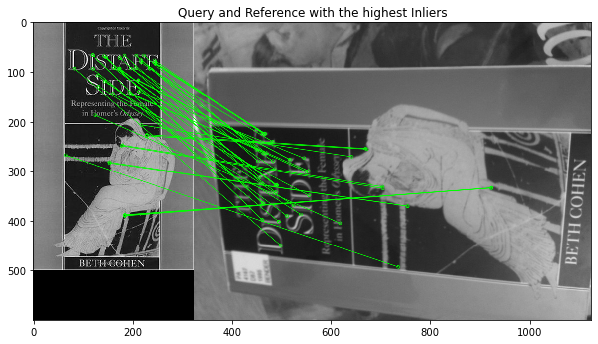

Index with the highest Inlier match is  1 with inliers 78


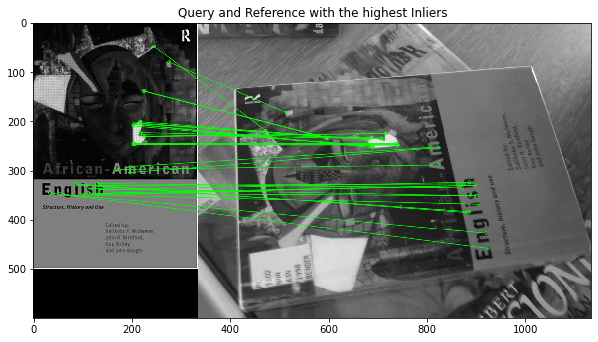

Index with the highest Inlier match is  2 with inliers 100


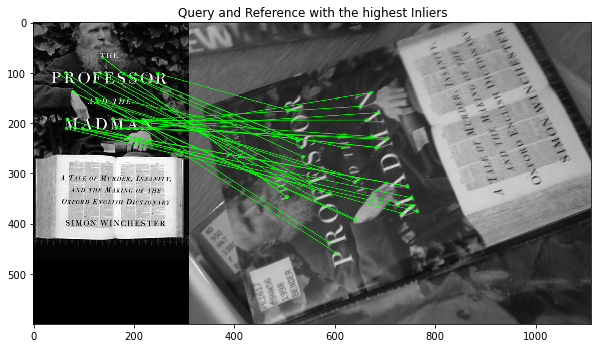

Not in Database
Not in Database
Index with the highest Inlier match is  5 with inliers 71


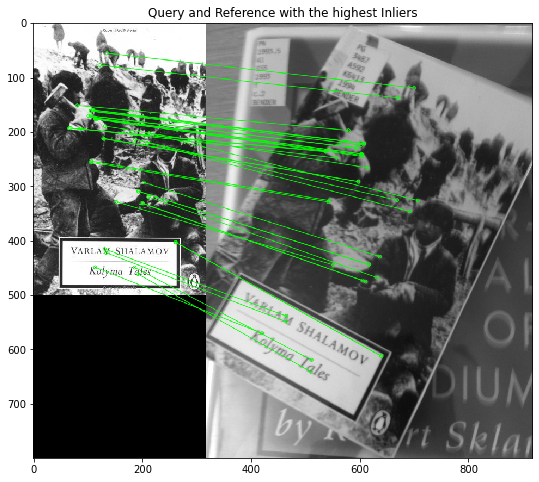

Index with the highest Inlier match is  6 with inliers 60


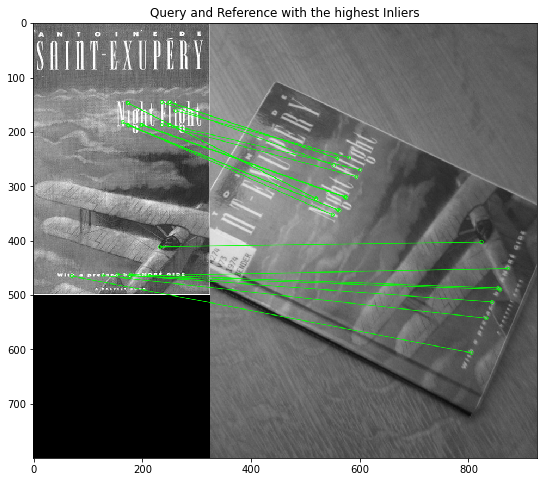

Not in Database
Index with the highest Inlier match is  8 with inliers 62


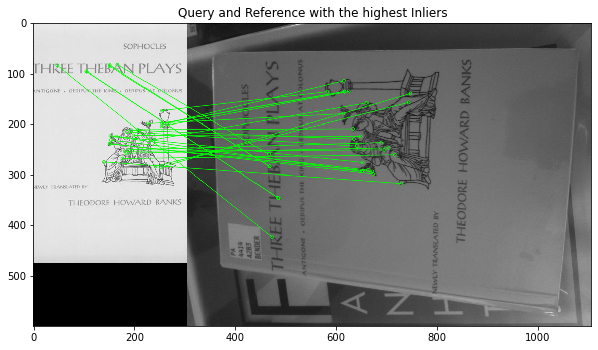

Index with the highest Inlier match is  9 with inliers 135


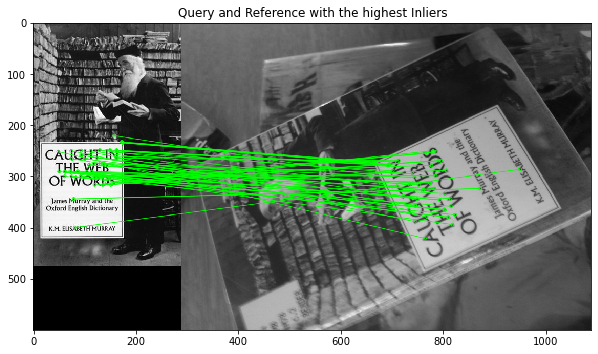

Index with the highest Inlier match is  10 with inliers 101


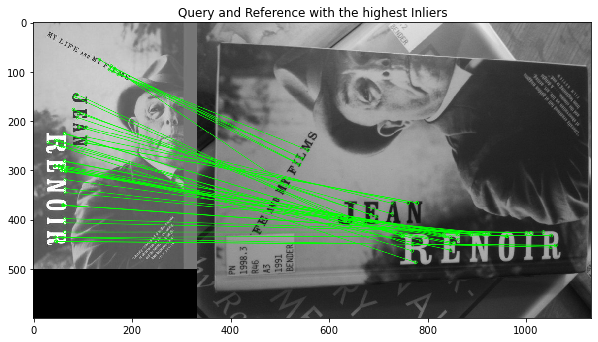

Index with the highest Inlier match is  11 with inliers 88


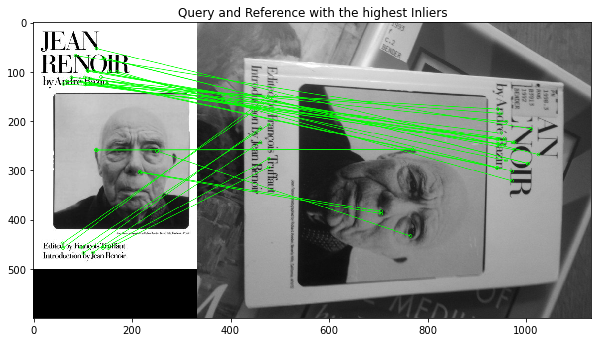

Index with the highest Inlier match is  12 with inliers 82


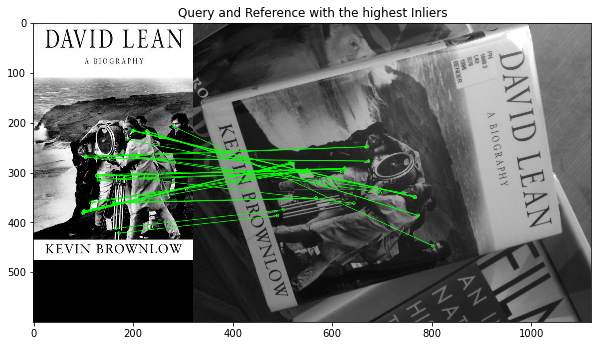

Index with the highest Inlier match is  13 with inliers 80


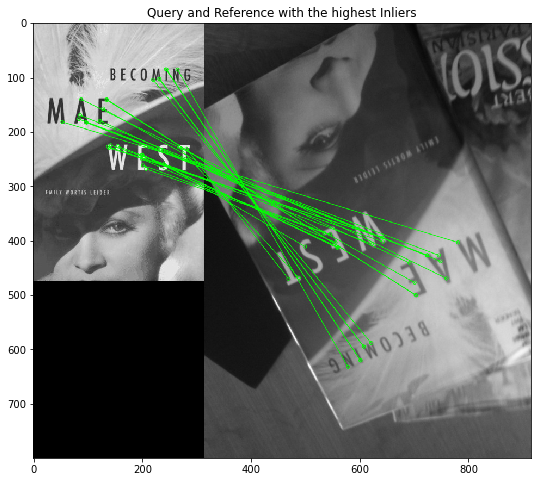

Index with the highest Inlier match is  14 with inliers 78


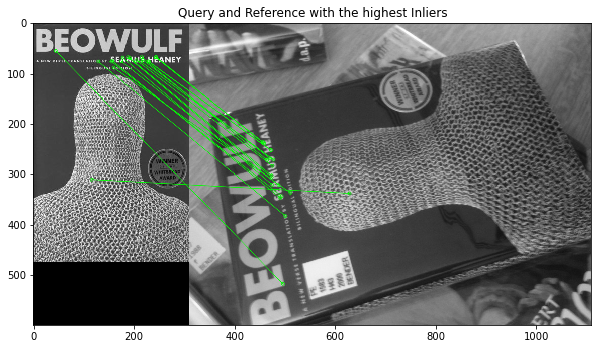

Not in Database
Index with the highest Inlier match is  16 with inliers 88


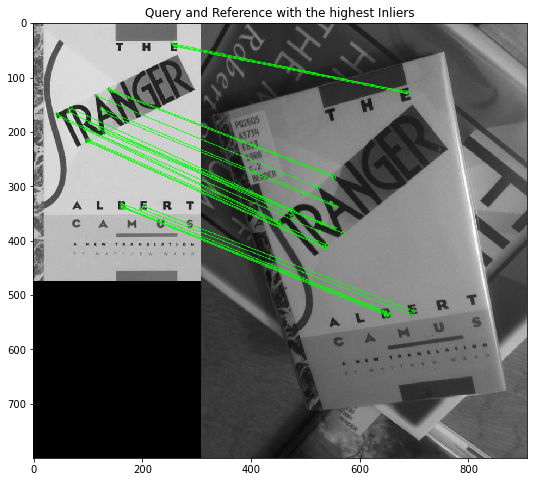

Not in Database
Index with the highest Inlier match is  18 with inliers 57


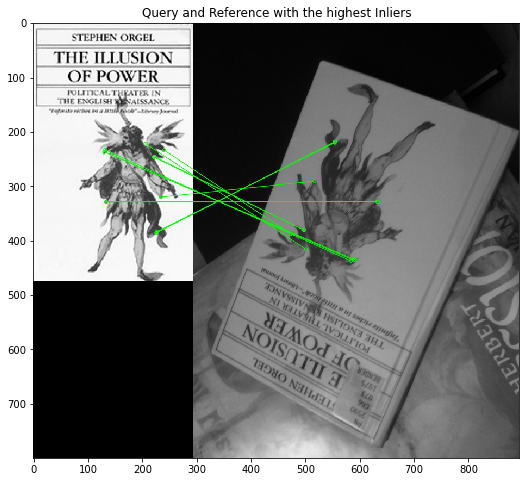

Index with the highest Inlier match is  19 with inliers 122


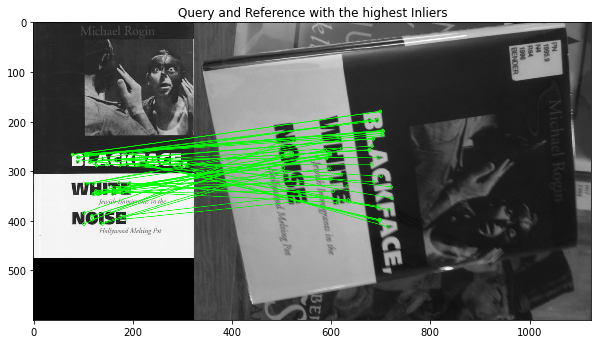

Not in Database
Not in Database
Not in Database
Not in Database
Not in Database
Total number of failed cases below a threshold of 50 are  10


In [29]:
# Your code to run extra queries and display results here
list_imgs = getsetOfReferenceImages(refernce_file_path, no_of_images = 20)
selected_query_image_list = getsetOfQueryImages(query_file_path, no_of_images = 20)

query_images_list = []
for i in range(50,55):
    if(i < 10):
        image_path = query_file_path + '00' + str(i) + '.jpg'
    else:
        image_path = query_file_path + '0' + str(i) + '.jpg'
    img = readImage(image_path)
    selected_query_image_list.append(img)      
    
threshold_vaue = 50
failed_cases = 0

#Creating an ORB object 
selected_query_img = readImage(selected_query_imagePath)
matching_approach = getORB_Object()
bf = getBFMatcherObj(norm = cv2.NORM_HAMMING)

ref_img_kp_list = []
ref_img_score_list = []
selected_query_kp = None

for index in range(0,len(selected_query_image_list)):
    selected_query_img = selected_query_image_list[index]
    ref_img_kp_list = []
    ref_img_score_list = []
    selected_query_kp = None

    for ref_img in list_imgs:
        selected_query_kp, r_kp, matches, result = FeatureMatchingPipeline(selected_query_img, ref_img, matching_approach, bf)
        ref_img_kp_list.append(r_kp)
        model, mask = performHomoGraphy(selected_query_kp, r_kp, matches, method = cv2.RANSAC)
        ref_img_score = 0
        for a in mask.ravel().tolist():
            if a == 1:
                ref_img_score += 1
        ref_img_score_list.append(ref_img_score)

    highest_index = np.argmax(ref_img_score_list)
    if(ref_img_score_list[highest_index] < threshold_vaue):
        print('Not in Database')
        failed_cases += 1
        continue 
    
    print('Index with the highest Inlier match is ', highest_index, 'with inliers', ref_img_score_list[highest_index])
    q_kp, r_kp, matches = prepareForHomoGraphy(selected_query_img, list_imgs[highest_index])
    model_landmark_ransac, matchesMask = performHomoGraphy(q_kp, r_kp, matches, homography_method_list[1], 5)
    draw_inliers(list_imgs[highest_index],selected_query_img,r_kp,q_kp,matches, matchesMask, 'Query and Reference with the highest Inliers')

print('Total number of failed cases below a threshold of 50 are ', failed_cases)



## Explanation
As the number of query increased in the database, the accurancy increased as expected due to the absence of those images in the reference set. The accurancy dropped from  75% (15/20) to 60% (15/20)


6. Repeat step 4 and 5 for at least one other set of reference images from museum_paintings or landmarks, and compare the accuracy obtained. Analyse both your overall result and individual image matches to diagnose where problems are occurring, and what you could do to improve performance. Test at least one of your proposed improvements and report its effect on accuracy.


Index with the highest Inlier match is  11 with inliers 9


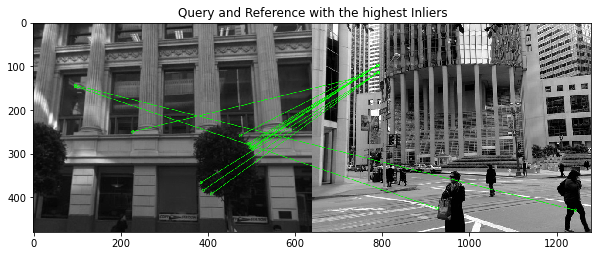

Index with the highest Inlier match is  1 with inliers 10


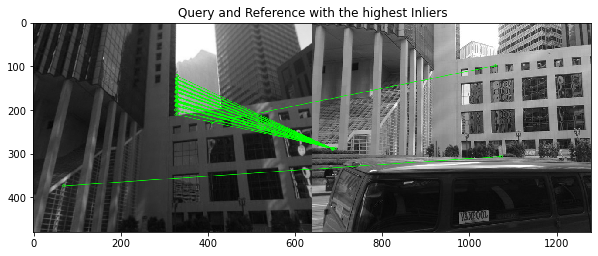

Index with the highest Inlier match is  0 with inliers 8


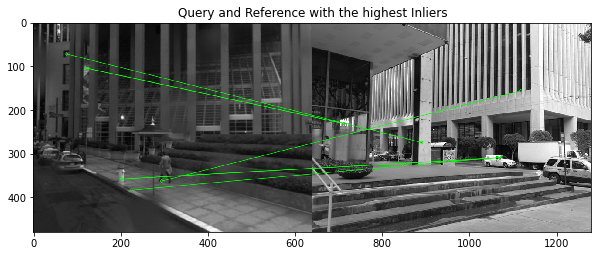

Index with the highest Inlier match is  6 with inliers 11


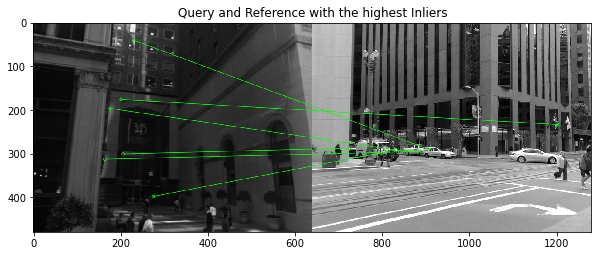

Index with the highest Inlier match is  2 with inliers 9


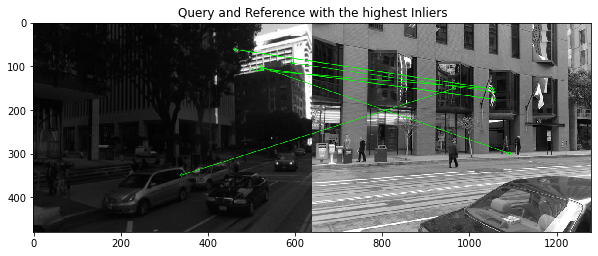

Index with the highest Inlier match is  3 with inliers 8


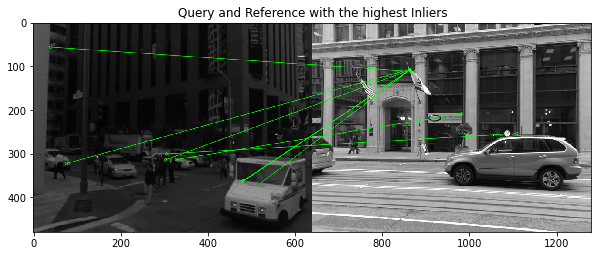

Index with the highest Inlier match is  6 with inliers 17


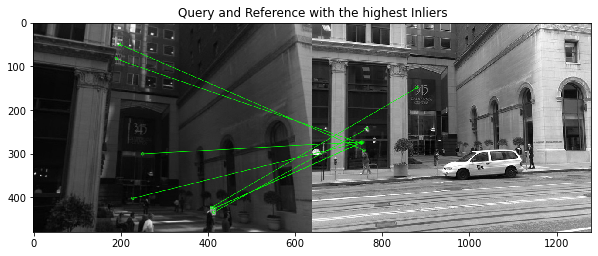

Index with the highest Inlier match is  0 with inliers 8


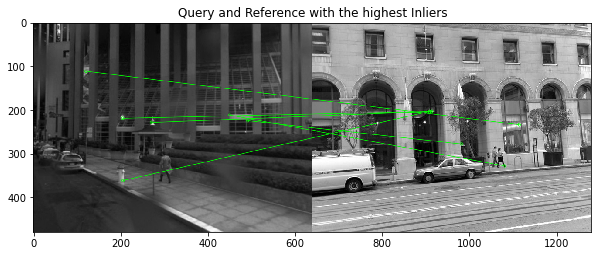

Index with the highest Inlier match is  6 with inliers 8


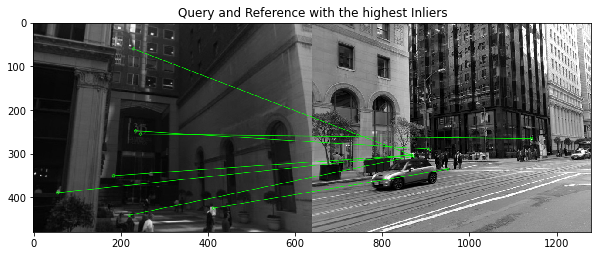

Index with the highest Inlier match is  10 with inliers 10


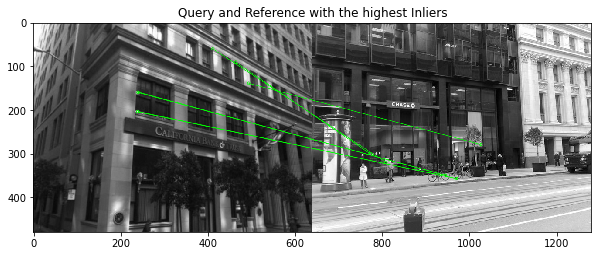

Index with the highest Inlier match is  0 with inliers 8


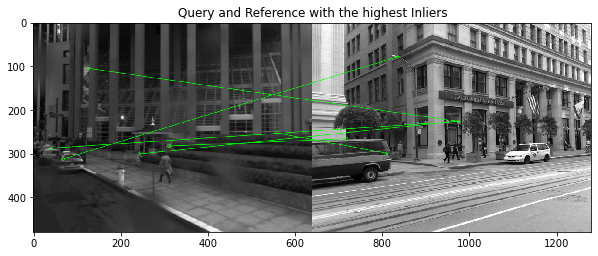

Index with the highest Inlier match is  11 with inliers 10


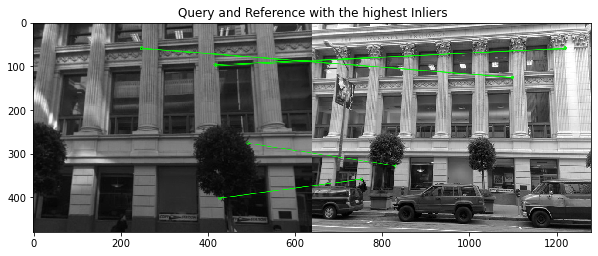

Index with the highest Inlier match is  17 with inliers 11


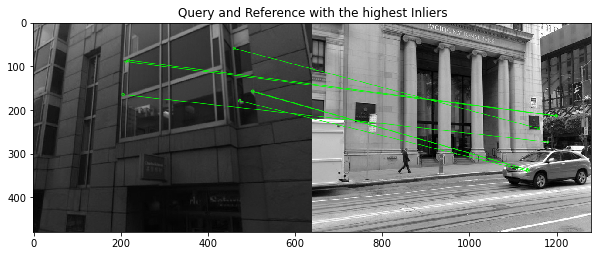

Index with the highest Inlier match is  13 with inliers 11


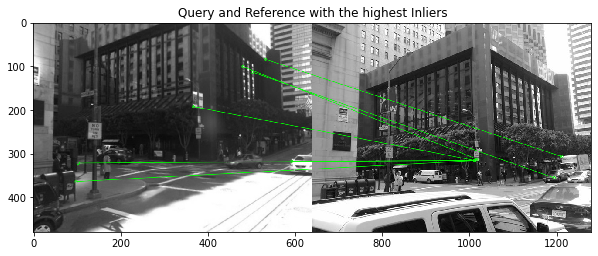

Index with the highest Inlier match is  3 with inliers 8


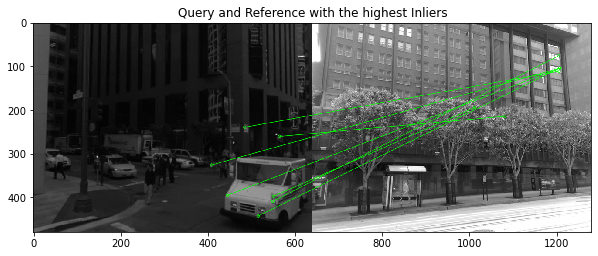

Index with the highest Inlier match is  0 with inliers 8


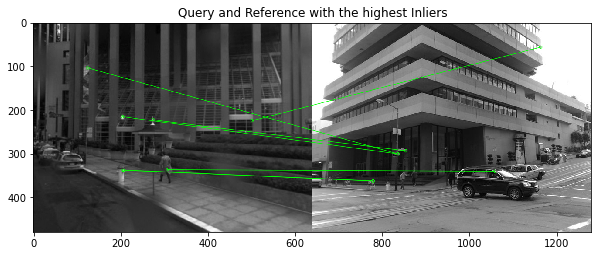

Index with the highest Inlier match is  16 with inliers 15


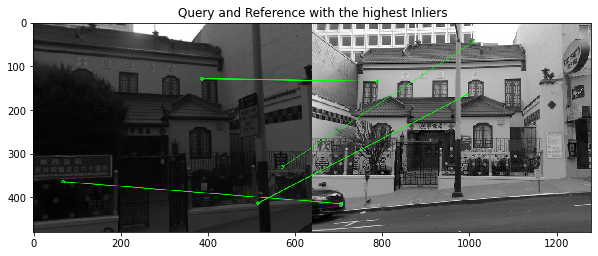

Index with the highest Inlier match is  17 with inliers 9


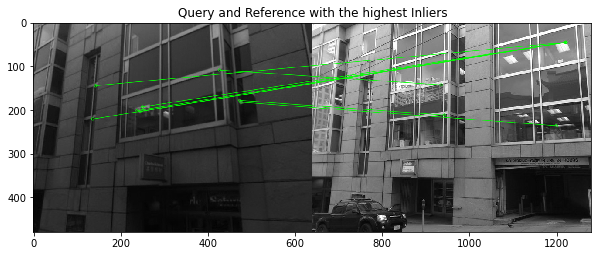

Index with the highest Inlier match is  18 with inliers 22


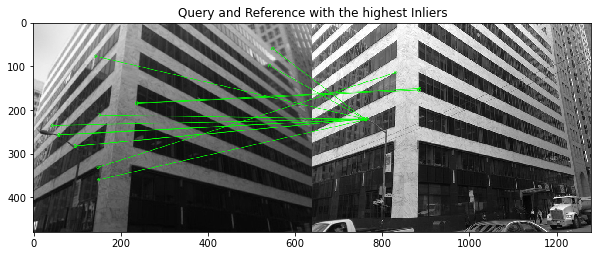

Index with the highest Inlier match is  19 with inliers 15


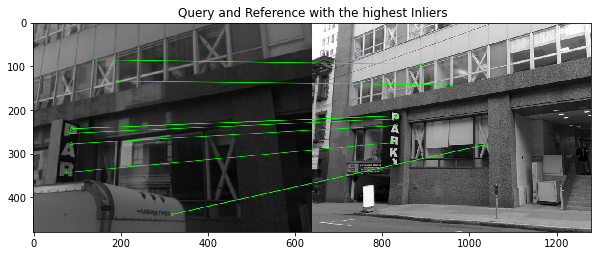

Total number of failed cases below a threshold of 50 are  0


In [30]:
landmark_refernce_file_path = "/Users/ishan/Downloads/Tri-Sem-2/Computer Vision/Assignments/A2/A2_smvs/landmarks/Reference/"
landmark_query_file_path = "/Users/ishan/Downloads/Tri-Sem-2/Computer Vision/Assignments/A2/A2_smvs/landmarks/Query/"

landmark_list_imgs = getsetOfReferenceImages(landmark_refernce_file_path, no_of_images = 20)

landmark_query_image_list = getsetOfQueryImages(landmark_query_file_path,no_of_images = 20)


threshold_vaue = 5
failed_cases = 0

#Creating an ORB object 
matching_approach = getORB_Object()
bf = getBFMatcherObj(norm = cv2.NORM_HAMMING)

ref_img_kp_list = []
ref_img_score_list = []
selected_query_kp = None

for index in range(0,len(landmark_query_image_list)):
    selected_query_img = landmark_query_image_list[index]
    ref_img_kp_list = []
    ref_img_score_list = []
    selected_query_kp = None

    for ref_img in landmark_list_imgs:
        selected_query_kp, r_kp, matches, result = FeatureMatchingPipeline(selected_query_img, ref_img, matching_approach, bf)
        ref_img_kp_list.append(r_kp)
        model, mask = performHomoGraphy(selected_query_kp, r_kp, matches, method = cv2.RANSAC)
        ref_img_score = 0
        for a in mask.ravel().tolist():
            if a == 1:
                ref_img_score += 1
        ref_img_score_list.append(ref_img_score)

    highest_index = np.argmax(ref_img_score_list)
    if(ref_img_score_list[highest_index] < threshold_vaue):
        print('Not in Database')
        failed_cases += 1
        continue 
    
    print('Index with the highest Inlier match is ', highest_index, 'with inliers', ref_img_score_list[highest_index])
    q_kp, r_kp, matches = prepareForHomoGraphy(selected_query_img, landmark_list_imgs[highest_index])
    model_landmark_ransac, matchesMask = performHomoGraphy(q_kp, r_kp, matches, homography_method_list[1], 5)
    draw_inliers(landmark_list_imgs[highest_index],selected_query_img,r_kp,q_kp,matches, matchesMask, 'Query and Reference with the highest Inliers')

print('Total number of failed cases below a threshold of 50 are ', failed_cases)

# Question 3 Try on real world images(10%)

In this question, we provide two real world images (img1 and img2). Please try to apply the techniques you learned in this assignment to do a match for these two images.

Try to improve you matching score and explain how you implement that.

Hint1: You can first resize the images to 512*512 and then do the matching.



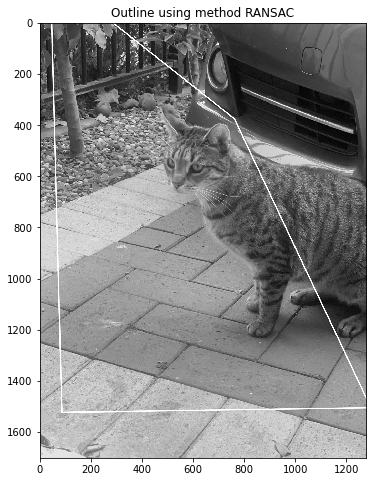

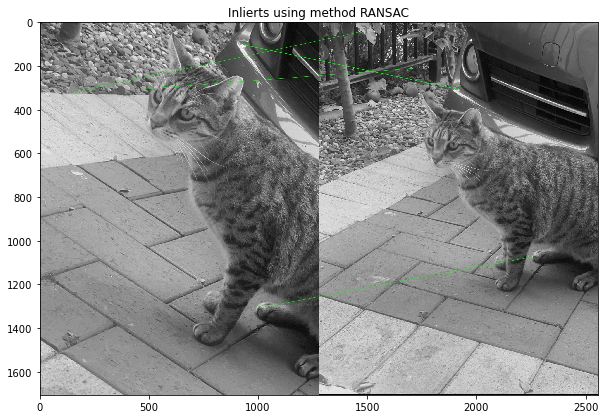

In [31]:
#RANSAC with Default Threshold
homography_method_list = [None, cv2.RANSAC, cv2.LMEDS, cv2.RHO]

real_query_img = readImage('/Users/ishan/Downloads/Tri-Sem-2/Computer Vision/Assignments/A2/clean/img1.jpeg')
real_reference_img = readImage('/Users/ishan/Downloads/Tri-Sem-2/Computer Vision/Assignments/A2/clean/img2.jpeg')

real_query_kp_ransac, real_ref_kp_ransac, real_matches_list_ransac = prepareForHomoGraphy(real_query_img, real_reference_img)

real_model_ransac, real_matchesMask_ransac = performHomoGraphy(real_query_kp_ransac, real_ref_kp_ransac, real_matches_list_ransac, homography_method_list[1])

# draw frame
draw_outline(real_reference_img,real_query_img, real_model_ransac, 'Outline using method RANSAC')

# draw inliers
draw_inliers(real_reference_img,real_query_img,real_ref_kp_ransac,real_query_kp_ransac,real_matches_list_ransac, real_matchesMask_ransac, 'Inlierts using method RANSAC')